<a href="https://colab.research.google.com/github/Mostofa-Najmus-Sakib/Data-Science-CS533/blob/main/Assisgnment2/Assisgnment_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# CS 533 Assignment 2: Public Health¶

### Loading required softwares

In [ ]:
conda install plotly geopandas

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\Sajon_PC\Anaconda3

  added / updated specs:
    - geopandas
    - plotly


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    plotly-4.1.1               |             py_0         4.0 MB
    ------------------------------------------------------------
                                           Total:         4.0 MB

The following packages will be SUPERSEDED by a higher-priority channel:

  plotly                                             plotly --> pkgs/main




plotly-4.1.1         | 4.0 MB    |            |   0% 
plotly-4.1.1         | 4.0 MB    |            |   0% 
plotly-4.1.1         | 4.0 MB    | ###1       |  31% 
plotly-4.1.1         | 4.0 MB    | ######4    |  65% 
plotly-4.1.1         | 4.0 MB    | ########## | 100% 
Preparing transaction: ...working... done
Verifying transaction: ...w

In [ ]:
conda install -c plotly plotly plotly-geo

Solving environment: ...working... done

## Package Plan ##

  environment location: C:\Users\Sajon_PC\Anaconda3

  added / updated specs:
    - plotly
    - plotly-geo


The following packages will be downloaded:

    package                    |            build
    ---------------------------|-----------------
    plotly-4.1.1               |             py_0         4.0 MB  plotly
    ------------------------------------------------------------
                                           Total:         4.0 MB

The following packages will be SUPERSEDED by a higher-priority channel:

  plotly                                          pkgs/main --> plotly




plotly-4.1.1         | 4.0 MB    |            |   0% 
plotly-4.1.1         | 4.0 MB    |            |   0% 
plotly-4.1.1         | 4.0 MB    | 1          |   1% 
plotly-4.1.1         | 4.0 MB    | 1          |   2% 
plotly-4.1.1         | 4.0 MB    | 2          |   3% 
plotly-4.1.1         | 4.0 MB    | 4          |   5% 
plotly-4.

In [ ]:
%pip install census us
%pip install geopandas==0.3.0
%pip install pyshp==1.2.10
%pip install shapely==1.6.3

Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.
Note: you may need to restart the kernel to use updated packages.


### Loading the libraries

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from census import Census
from us import states
import statsmodels.api as sm
import statsmodels.formula.api as smf
import os
import glob
import plotly.graph_objects as go
import plotly.figure_factory as ff

# Loading Census Data

In [ ]:
%pip install census us

Note: you may need to restart the kernel to use updated packages.


In [ ]:
c = Census('')

###  Census for states

#### Lets load the census data for states only

In [ ]:
s_pop = c.acs.state(('NAME','C27017_001E','C27017_002E','B00001_001E'),'*', year=2014)

Creating dataframe from the dict data

In [ ]:
s_df_pop = pd.DataFrame(s_pop)

In [ ]:
s_df_pop.head()

,B00001_001E,C27017_001E,C27017_002E,NAME,state
0,399744,4687615.0,1294017.0,Alabama,01
1,95089,699593.0,114151.0,Alaska,02
2,454290,6399873.0,1711028.0,Arizona,04
3,242391,2857966.0,815516.0,Arkansas,05
4,2749907,37243757.0,9127115.0,California,06


Rename state column to FIPS

In [ ]:
s_df_pop.rename(columns={
    'state': 'FIPS'
    ,'C27017_001E':'total population'
    ,'C27017_002E':'population under poverty'}, inplace=True)
s_df_pop.head()

,B00001_001E,total population,population under poverty,NAME,FIPS
0,399744,4687615.0,1294017.0,Alabama,01
1,95089,699593.0,114151.0,Alaska,02
2,454290,6399873.0,1711028.0,Arizona,04
3,242391,2857966.0,815516.0,Arkansas,05
4,2749907,37243757.0,9127115.0,California,06


### Census for county

Lets load the census data for county only

In [ ]:
c_pop = c.acs.state_county(('NAME', 'C27017_001E','C27017_002E','B00001_001E'),'*','*',year=2014)

Creating dataframe from the dict data

In [ ]:
c_df_pop = pd.DataFrame(c_pop)

Rename state column to FIPS

In [ ]:
c_df_pop.rename(columns={
    'state': 'FIPS'
    ,'C27017_001E':'total population'
    ,'C27017_002E':'population under poverty'}, inplace=True)

# Loading GDP data from BEA

In [ ]:
gdp = pd.read_excel('GCP_Release_1.xlsx', header=3)

Due to cell merging, some columns are unnamed. We can fix that:

In [ ]:
gdp.rename(columns={
    'Unnamed: 0': 'FIPS',
    'Unnamed: 1': 'County',
    'Unnamed: 2': 'State',
    'Unnamed: 3': 'LineCode', 
    'Unnamed: 4': 'Industries',
    }, inplace=True)
gdp.head()

,FIPS,County,State,LineCode,Industries,2012,2013,2014,2015
0,01001,Autauga,AL,1.0,All Industries,1383941,1363368,1402516,1539406
1,01001,Autauga,AL,2.0,Private goods-producing industries,286396,310468,323582,346355
2,01001,Autauga,AL,3.0,Private services-providing industries,948490,904599,928438,1037309
3,01001,Autauga,AL,4.0,Government and government enterprises,149055,148301,150496,155742
4,01003,Baldwin,AL,1.0,All Industries,5599194,6365080,6547396,6436107


Let's look at the bottom, to see if it matches:

In [ ]:
gdp.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12456 entries, 0 to 12455
Data columns (total 9 columns):
FIPS          12455 non-null object
County        12452 non-null object
State         12452 non-null object
LineCode      12452 non-null float64
Industries    12452 non-null object
2012          12452 non-null object
2013          12452 non-null object
2014          12452 non-null object
2015          12452 non-null object
dtypes: float64(1), object(8)
memory usage: 875.9+ KB


We need to trim off the data at the bottom - nuisance values we don't care about. We also only care about LineCode = 1 - let's filter for that:"

In [ ]:
gdp = gdp[gdp['LineCode'] == 1.0]

Now that the docs are gone, we can make FIPS a number.

In [ ]:
gdp['FIPS'] = gdp['FIPS'].astype('i4')
gdp.head()

,FIPS,County,State,LineCode,Industries,2012,2013,2014,2015
0,1001,Autauga,AL,1.0,All Industries,1383941,1363368,1402516,1539406
4,1003,Baldwin,AL,1.0,All Industries,5599194,6365080,6547396,6436107
8,1005,Barbour,AL,1.0,All Industries,639833,701750,689212,743779
12,1007,Bibb,AL,1.0,All Industries,297560,325906,329087,322307
16,1009,Blount,AL,1.0,All Industries,632761,701145,688525,819608


Change the numeric column (object) to string

In [ ]:
gdp.columns = gdp.columns.astype(str)
gdp.columns.map(type)

Index([<class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>, <class 'str'>, <class 'str'>, <class 'str'>,
       <class 'str'>],
      dtype='object')

# Loading US health data

First, we list the datasets' names from the data folder, This dataset consists of .csv files of United States infectious disease mortality rates by county (1980-2014) of each state. Therefore to automate the proccess we make a list of their names and load them all based on the list.

In [ ]:
datasets = os.listdir("C:/Class materials/CS_533/Assignment/a2/Assignment 2_data/Data/healthdata")

In [ ]:
len(datasets)

52

Lets use the list to stack data on top of each other to create a new dataframe containing all states infectious disease mortality rates.

In [ ]:
Mort_rate = pd.concat((pd.read_csv(f'Assignment 2_data/Data/healthdata/{ds}') for ds in datasets),ignore_index=True)
Mort_rate.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
0,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1980,Rate,2.359759,2.094300,2.638586
1,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1981,Rate,2.334274,2.095113,2.599191
2,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1982,Rate,2.270024,2.032332,2.525627
3,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1983,Rate,2.165274,1.956440,2.385901
4,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1984,Rate,2.121463,1.910553,2.343087


In [ ]:
Mort_rate = Mort_rate.sort_values(by = ['FIPS'])
#Mort_rate.tail()

The Mortality rates has Nan values at the bottom, so I have dropped NaN FIPS from the data

In [ ]:
Mort_rate.dropna(subset=['FIPS'],inplace=True)

# 1. Initial Load and Exploration

 How are state-level mortality rates distributed for each disease class? Show the distribution (as a histogram), and describe it numerically. It will be easiest to understand the histograms with side-by-side plots; see Seaborn’s FacetGrid for this. You will probably want to tweak the ‘sharex’ and ‘sharey’ options to make the plots more readable.

Lets Split the data into state- and county-level data frames:

### 1.1.1 State level mortality rates

The hightest state Fips code belong to VIRGIN ISLANDS with FIPS:78 so we use boolean logic with threshold 80 to seperate state and county

In [ ]:
Mortality_df_state0 = Mort_rate[Mort_rate['FIPS'] < 80]
Mortality_df_state0.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
0,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1980,Rate,2.359759,2.094300,2.638586
14341,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2006,Rate,2.237022,1.022623,2.486914
14342,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2007,Rate,2.274337,0.994550,2.528656
14343,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2008,Rate,2.453514,0.988253,2.730467
14344,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2009,Rate,2.474892,0.974789,2.749556


Then we select only 2014

In [ ]:
Mortality_df_state = Mortality_df_state0[Mortality_df_state0['year_id'] == 2014]
Mortality_df_state.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
14349,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2014,Rate,2.576625,0.998915,2.898589
14314,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,1,Male,27,Age-standardized,2014,Rate,2.121498,0.514955,2.547804
35769,1,Deaths,523,Alabama,1.0,400,Hepatitis,2,Female,27,Age-standardized,2014,Rate,0.170632,0.145256,0.198894
14384,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,3,Both,27,Age-standardized,2014,Rate,2.406220,0.891999,2.703369
35804,1,Deaths,523,Alabama,1.0,400,Hepatitis,3,Both,27,Age-standardized,2014,Rate,0.239779,0.211671,0.270458


Finally we select only the Both gender

In [ ]:
Mortality_df_state = Mortality_df_state[Mortality_df_state['sex'] == 'Both']
Mortality_df_state.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
14384,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,3,Both,27,Age-standardized,2014,Rate,2.406220,0.891999,2.703369
35804,1,Deaths,523,Alabama,1.0,400,Hepatitis,3,Both,27,Age-standardized,2014,Rate,0.239779,0.211671,0.270458
7244,1,Deaths,523,Alabama,1.0,298,HIV/AIDS,3,Both,27,Age-standardized,2014,Rate,2.585321,2.463196,2.705264
21524,1,Deaths,523,Alabama,1.0,322,Lower respiratory infections,3,Both,27,Age-standardized,2014,Rate,37.393408,35.790752,39.118901
28664,1,Deaths,523,Alabama,1.0,332,Meningitis,3,Both,27,Age-standardized,2014,Rate,0.582372,0.536641,0.639067


Now we convert to a tall data frame:

In [ ]:
Mortality_tall_state = Mortality_df_state.pivot(index ='FIPS', columns ='cause_name', values ='mx') 
#Mortality_tall_state.head()

Lets plot the state level mortality rate for all the diseases

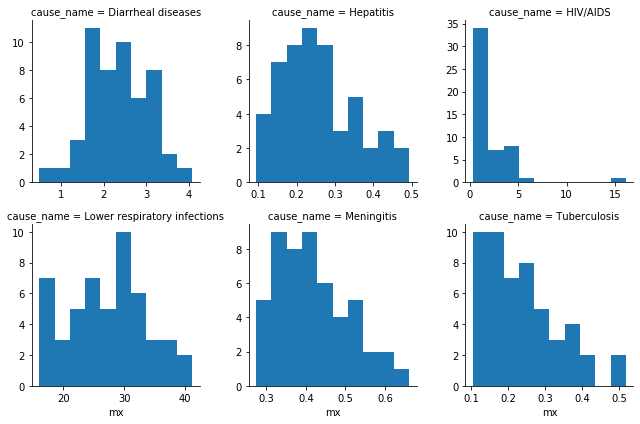

In [ ]:
State_mort_dist = sns.FacetGrid(Mortality_df_state, col="cause_name",   margin_titles = True, col_wrap = 3, sharex = False, sharey = False).map(plt.hist, "mx")

The mortality rates for the states shows that for HIV, Tuberculosis its right skewed

For Diarrheal & Hepatitis disease its close to normal distribution 

In [ ]:
Mortality_tall_state.describe()

cause_name,Diarrheal diseases,HIV/AIDS,Hepatitis,Lower respiratory infections,Meningitis,Tuberculosis
count,51.000000,51.000000,51.000000,51.000000,51.000000,51.000000
mean,2.356091,2.044772,0.253810,27.163165,0.415890,0.237026
std,0.714691,2.417237,0.101243,6.272960,0.091943,0.101219
min,0.485747,0.338506,0.094369,16.101937,0.274685,0.105845
25%,1.805994,0.747444,0.175431,23.018824,0.347398,0.162280
50%,2.307500,1.262752,0.231361,28.099666,0.402716,0.203494
75%,2.850635,2.480456,0.316040,31.285950,0.469664,0.291722
max,4.083346,16.105768,0.492770,41.107162,0.660877,0.518633


From both the figure and stat table it can be seen that Diarrheal and Hepatitis diseases are almost normaly distributed accross states, whereas HIV/AIDS is heavily skewed to the left.

### 1.1.2 County level mortality rates

In [ ]:
county_Mort_rate = Mort_rate[Mort_rate['FIPS']>80]
county_Mort_rate.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
21550,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2005,Rate,42.565059,36.635814,49.088818
21551,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2006,Rate,39.247843,33.627375,45.366478
21553,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2008,Rate,40.594734,34.977506,46.940896
21554,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2009,Rate,38.989043,33.185272,45.327352
21559,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2014,Rate,41.752309,35.745240,48.245912


Since for the state we checked the FIPS having value less than were for states, so all the values greater than 80 would be for counties, we did this in the previous cell

Then we select only 2014

In [ ]:
Mortality_df_county = county_Mort_rate[county_Mort_rate['year_id'] == 2014]

Finally we select only the Both gender

In [ ]:
Mortality_df_county = Mortality_df_county[Mortality_df_county['sex'] == 'Both']
Mortality_df_county.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
209,1,Deaths,614,Autauga County,1001.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.309921,0.201189,0.438177
28769,1,Deaths,614,Autauga County,1001.0,332,Meningitis,3,Both,27,Age-standardized,2014,Rate,0.514925,0.411304,0.629159
14489,1,Deaths,614,Autauga County,1001.0,302,Diarrheal diseases,3,Both,27,Age-standardized,2014,Rate,1.889825,0.743934,2.644969
35909,1,Deaths,614,Autauga County,1001.0,400,Hepatitis,3,Both,27,Age-standardized,2014,Rate,0.197764,0.128353,0.276852
7349,1,Deaths,614,Autauga County,1001.0,298,HIV/AIDS,3,Both,27,Age-standardized,2014,Rate,1.995046,1.455465,2.564078


Now we convert to a tall data frame:

In [ ]:
Mortality_tall_county = Mortality_df_county.pivot(index ='FIPS', columns ='cause_name', values ='mx') 
Mortality_tall_county.head()

cause_name,Diarrheal diseases,HIV/AIDS,Hepatitis,Lower respiratory infections,Meningitis,Tuberculosis
FIPS,,,,,,
1001.0,1.889825,1.995046,0.197764,34.153983,0.514925,0.309921
1003.0,1.436522,1.814896,0.210261,21.820851,0.414002,0.197299
1005.0,2.015340,4.030395,0.201652,33.954553,0.635688,0.416175
1007.0,2.707614,1.244898,0.200895,41.295744,0.612928,0.261805
1009.0,3.559936,1.053874,0.207240,54.023856,0.464294,0.258540


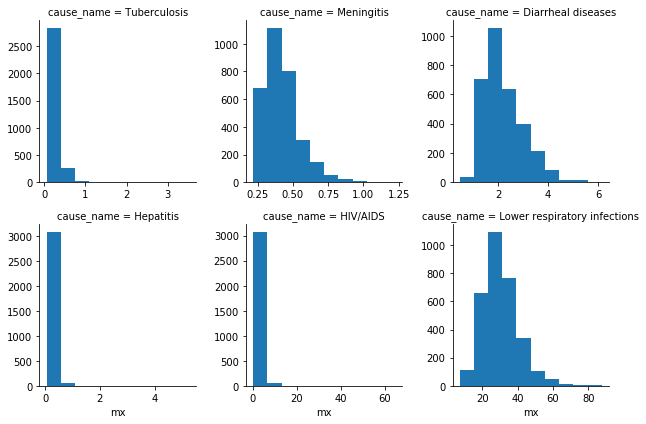

In [ ]:
County_mort_dist = sns.FacetGrid(Mortality_df_county, col="cause_name",   margin_titles = True, col_wrap = 3, sharex = False, sharey = False).map(plt.hist, "mx")

In [ ]:
Mortality_tall_county.describe()

cause_name,Diarrheal diseases,HIV/AIDS,Hepatitis,Lower respiratory infections,Meningitis,Tuberculosis
count,3142.000000,3142.000000,3142.000000,3142.000000,3142.000000,3142.000000
mean,2.210179,1.333057,0.220118,30.337976,0.421084,0.217900
std,0.781120,1.961501,0.155413,10.218042,0.126029,0.174057
min,0.470721,0.154699,0.056586,7.242285,0.217513,0.057117
25%,1.629510,0.447175,0.134477,23.443510,0.330283,0.115154
50%,2.031328,0.731724,0.189628,28.972474,0.399273,0.169081
75%,2.663454,1.437820,0.270877,35.884786,0.477695,0.265586
max,6.139848,64.871216,5.244210,87.696763,1.226104,3.507462


From both the figure and stat table it can be seen that at county level all diseases are skewed to the right and are not distributed normally.

# 1.2 GDP

## 1.2.1 State level GDP

Load the GDP and Census files, and describe the distributions of state- and county-level GDP, total population, and fraction of population under the poverty line. The fraction of population under the poverty line can be derived from variables C27017_001E and C27017_002E: 001 is the total, and 002 is the population under the poverty line; divide these variables

I have already loaded the GDP data, Now I want state GDP. First we idnetify states from FIPS and then we aggregate GDP of counties based on state ID

In [ ]:
state_gdp = gdp.assign(StateFIPS = gdp['FIPS'] // 1000).groupby('StateFIPS')[ '2014'].sum()
state_gdp.head()

StateFIPS
1     194059720
2      55547370
4     284573788
5     117339124
6    2396552112
Name: 2014, dtype: int64

GDP state level stats:

In [ ]:
state_gdp.describe()

count    5.100000e+01
mean     3.413308e+08
std      4.305805e+08
min      2.971440e+07
25%      8.523418e+07
50%      1.940597e+08
75%      4.457034e+08
max      2.396552e+09
Name: 2014, dtype: float64

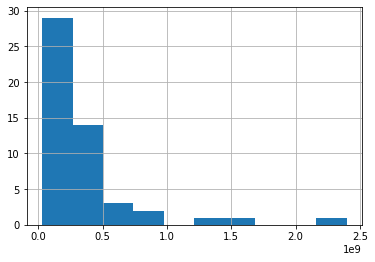

In [ ]:
state_gdp.hist()

The plot shows that the GDP value among states is right skewed

## 1.2.2 County level GDP

In [ ]:
gdp_county = gdp['2014']

In [ ]:
gdp_county.describe()

count       3113
unique      3112
top       417260
freq           2
Name: 2014, dtype: int64

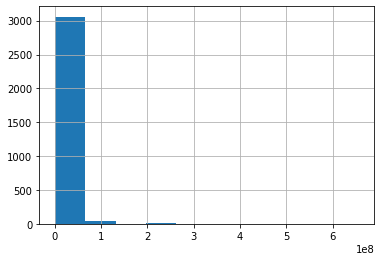

In [ ]:
gdp_county.hist()

simillarly the GDP values among counties are not normally distributed and is more skewed comapred to state-level GDP

## 1.3 Total population

### 1.3.1 State level total population

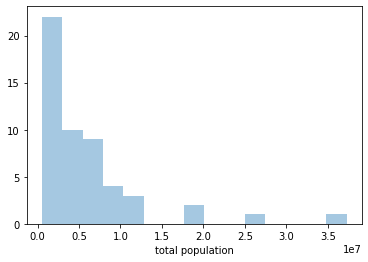

In [ ]:
sns.distplot(s_df_pop['total population'], kde = False)

In [ ]:
s_df_pop['total population'].describe()

count    5.200000e+01
mean     5.944674e+06
std      6.757276e+06
min      5.592060e+05
25%      1.739724e+06
50%      4.029804e+06
75%      6.497770e+06
max      3.724376e+07
Name: total population, dtype: float64

### 1.3.2 County level total population

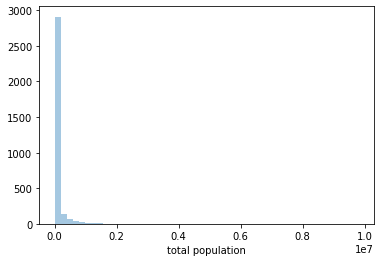

In [ ]:
sns.distplot(c_df_pop['total population'], kde = False)

In [ ]:
c_df_pop['total population'].describe()

count    3.220000e+03
mean     9.600094e+04
std      3.105923e+05
min      6.400000e+01
25%      1.077800e+04
50%      2.501750e+04
75%      6.391875e+04
max      9.815811e+06
Name: total population, dtype: float64

Distribution of both state and county population and GDP are very simillar, indicating that these two could be correlated to one another

## 1.4 Fraction of population under the poverty line

### 1.4.1 State level

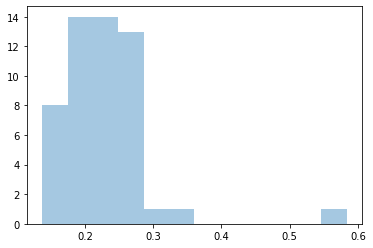

In [ ]:
sns.distplot(s_df_pop['population under poverty'].astype('i8')/s_df_pop['total population'].astype('i8'), kde = False)

In [ ]:
data1 = s_df_pop['population under poverty'].astype('i8')/s_df_pop['total population'].astype('i8')
data1.describe()

count    52.000000
mean      0.228754
std       0.066057
min       0.137451
25%       0.189877
50%       0.226345
75%       0.261563
max       0.583228
dtype: float64

### 1.4.2 County level

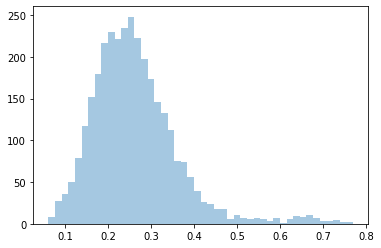

In [ ]:
sns.distplot(c_df_pop['population under poverty'].astype('i8')/c_df_pop['total population'].astype('i8'),kde=False)

In [ ]:
data2 = c_df_pop['population under poverty'].astype('i8')/c_df_pop['total population'].astype('i8')
data2.describe()

count    3220.000000
mean        0.262679
std         0.101315
min         0.061195
25%         0.195310
50%         0.249238
75%         0.310366
max         0.769123
dtype: float64

As expected the distributions of fraction of population under the poverty line in state and county level are not simillar to those of state and county level. Therefore it is unlikely that this parameter highly contibutes to the total population and GDP.

# 2. Spatial Visualization

Display the state- and county-level Tuberculosis and Lower Respiratory mortality rates on a maps, using Plotly’s Choropleth feature.

## 2.1 Tuberculosis visualization

### 2.1.1 State level

In [ ]:
Mortality_df_state_Tuberculosis = Mortality_df_state[Mortality_df_state['cause_name']=='Tuberculosis']
#Mortality_df_state_Tuberculosis.head()

we can get state codes from a different dataset from the internet for visualization and use them in our dataset

In [ ]:
State_codes = pd.read_csv('https://raw.githubusercontent.com/plotly/datasets/master/2011_us_ag_exports.csv')
#State_codes.head()

In [ ]:
Mortality_df_state_Tuberculosis = Mortality_df_state_Tuberculosis.merge(State_codes[['code','state']],how='inner',left_on='location_name',right_on='state')
#Mortality_df_state_Tuberculosis.head()

Now we plot the Tuberculosis mortality

In [ ]:
fig = go.Figure(data=go.Choropleth(
    locations=Mortality_df_state_Tuberculosis['code'],
    z=Mortality_df_state_Tuberculosis['mx'].astype(float),
    locationmode='USA-states',
    colorscale='plasma',
    autocolorscale=False,
    marker_line_color='white', # line markers between states
    colorbar_title="Posterior mean estimate of age-standardized mortality rates"
))

fig.update_layout(
    title_text='Tuberculosis mortality state-level',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()

It appears that in 2014 the southren states of US had the highest tuberculosis mortality rates

### 2.1.2 County level

In [ ]:
Mortality_df_county_Tuberculosis = Mortality_df_county[Mortality_df_county['cause_name']=='Tuberculosis']
#Mortality_df_county_Tuberculosis.head()

In [ ]:
fig = ff.create_choropleth(fips=Mortality_df_county_Tuberculosis['FIPS'],
                           values=Mortality_df_county_Tuberculosis['mx'].astype(float),
                           binning_endpoints=[0.1, 0.5, 1, 1.5, 2, 2.5, 3],
                           round_legend_values=True,
                           legend_title='Posterior mean estimate of age-standardized mortality rates', 
                           title='Tuberculosis mortality county-level')
fig.layout.template = None
fig.show()

C:\Users\Sajon_PC\Anaconda3\lib\site-packages\pandas\core\frame.py:6692: FutureWarning:

Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.




the map is showing that that in 2014 the southren counties of US had the highest tuberculosis mortality rates and in a few countys in south Dakota the tuberculosis mortality rates are the highest.

## 2.2 Lower Respiratory

### 2.2.1 State level

In [ ]:
Mortality_df_state_Respiratory = Mortality_df_state[Mortality_df_state['cause_name']=='Lower respiratory infections']
Mortality_df_state_Respiratory=Mortality_df_state_Respiratory.merge(State_codes[['code','state']],how='inner',left_on='location_name',right_on='state')
fig = go.Figure(data=go.Choropleth(
    locations=Mortality_df_state_Respiratory['code'],
    z=Mortality_df_state_Respiratory['mx'].astype(float),
    locationmode='USA-states',
    colorscale='plasma',
    autocolorscale=False,
    marker_line_color='white', # line markers between states
    colorbar_title="Posterior mean estimate of age-standardized mortality rates"
))

fig.update_layout(
    title_text='Lower respiratory infections mortality state-level',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()

The map is showing that that in 2014 the south eastren states of US had the highest respiratory mortality rates.

### 2.2.2 County level

In [ ]:
Mortality_df_county_Respiratory = Mortality_df_county[Mortality_df_county['cause_name']=='Lower respiratory infections']
fig = ff.create_choropleth(fips = Mortality_df_county_Respiratory['FIPS'],
                           values = Mortality_df_county_Respiratory['mx'].astype(float),
                           binning_endpoints=[10, 20, 30, 40, 50, 60, 70, 80],
                           round_legend_values=True,
                           legend_title='Posterior mean estimate of age-standardized mortality rates', 
                           title='Lower respiratory infections mortality county-levels')
                          
fig.layout.template = None
fig.show()

the map is showing that that in 2014 the south eastren counties of US had the highest respiratory mortality rates.

# 3. Dealing with Time

Show the change in state-level mortality rate (latest year - earliest year) for Tuberculosis, Lower Respiratory, and HIV/AIDS on a map.

Here I have loaded the mortality data for both 1980 and 2014 on seperate dataframe for Both gender and for specific disease and later substracted the first one with the later one to check the change in state level mortality rate

In [ ]:
Mortality_df_state1980 = pd.DataFrame(Mortality_df_state0[Mortality_df_state0['year_id'] == 1980])
Mortality_df_state = pd.DataFrame(Mortality_df_state0[Mortality_df_state0['year_id'] == 2014])

### 3.1.1 Tuberculosis:

select gender and disease

In [ ]:
Mortality_df_state1980_Tuberculosis = Mortality_df_state1980[(Mortality_df_state1980['sex'] == 'Both') & (Mortality_df_state1980['cause_name'] == 'Tuberculosis')].reset_index()
Mortality_df_state_Tuberculosis = Mortality_df_state[(Mortality_df_state['sex'] == 'Both') & (Mortality_df_state['cause_name'] == 'Tuberculosis')].reset_index()

know we subtract the two values of mx from 1980 and 2014 and normalize the data by dividing it by the sumation of the two. then it is assigned to a new column mx_Diff

In [ ]:
Mortality_df_state_Tuberculosis['mx_Diff'] = (Mortality_df_state_Tuberculosis['mx'] - Mortality_df_state1980_Tuberculosis['mx']) / (Mortality_df_state_Tuberculosis['mx'] + Mortality_df_state1980_Tuberculosis['mx'])
Mortality_df_state_Tuberculosis.head()

,index,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper,mx_Diff
0,104,1,Deaths,523,Alabama,1.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.355667,0.321425,0.387352,-0.608095
1,42944,1,Deaths,524,Alaska,2.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.518633,0.398954,0.671951,-0.697149
2,61844,1,Deaths,525,Arizona,4.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.258537,0.230131,0.285855,-0.723566
3,71924,1,Deaths,526,Arkansas,5.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.317000,0.283194,0.352605,-0.529859
4,119804,1,Deaths,527,California,6.0,297,Tuberculosis,3,Both,27,Age-standardized,2014,Rate,0.327106,0.306740,0.346697,-0.719449


In [ ]:
Mortality_df_state_Tuberculosis=Mortality_df_state_Tuberculosis.merge(State_codes[['code','state']],how='inner',left_on='location_name',right_on='state')
fig = go.Figure(data=go.Choropleth(
    locations=Mortality_df_state_Tuberculosis['code'],
    z=Mortality_df_state_Tuberculosis['mx_Diff'].astype(float),
    locationmode='USA-states',
    colorscale='picnic',
    autocolorscale=False,
    marker_line_color='white', # line markers between states
    colorbar_title="normalized posterior mean estimate of age-standardized mortality rates"
))

fig.update_layout(
    title_text='normalized difference of Tuberculosis infections mortality state-level',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()

The map is showing that that the change in Tuberculosis mortality rates from 1980 to 2014 is mostly negative indicating reduction in Tuberculosis mortality. the highest reduction in Tuberculosis mortality rate belongs to north eastern and north westren parts of US.

### 3.1.2 Lower Respiratory:

In [ ]:
Mortality_df_state1980_Respiratory = Mortality_df_state1980[(Mortality_df_state1980['sex'] == 'Both') & (Mortality_df_state1980['cause_name'] == 'Lower respiratory infections')].reset_index()
Mortality_df_state_Respiratory = Mortality_df_state[(Mortality_df_state['sex'] == 'Both') & (Mortality_df_state['cause_name'] == 'Lower respiratory infections')].reset_index()
#Mortality_df_state1980_Respiratory.head(10)

know we subtract the two values of mx from 1980 and 2014 and normalize the data by dividing it by the sumation of the two. then it is assigned to a new column mx_Diff

In [ ]:
Mortality_df_state_Respiratory['mx_Diff'] = (Mortality_df_state_Respiratory['mx'] - Mortality_df_state1980_Respiratory['mx']) / (Mortality_df_state_Respiratory['mx'] + Mortality_df_state1980_Respiratory['mx'])
#Mortality_df_state_Respiratory.head()

In [ ]:
Mortality_df_state_Respiratory = Mortality_df_state_Respiratory.merge(State_codes[['code','state']],how='inner',left_on='location_name',right_on='state')
fig = go.Figure(data=go.Choropleth(
    locations=Mortality_df_state_Respiratory['code'],
    z=Mortality_df_state_Respiratory['mx_Diff'].astype(float),
    locationmode='USA-states',
    colorscale='redor',
    autocolorscale=False,
    marker_line_color='white', # line markers between states
    colorbar_title="normalized posterior mean estimate of age-standardized mortality rates"
))

fig.update_layout(
    title_text='normalized difference of Respiratory infections mortality state-level',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()

The map is showing that that the change in Respiratory mortality rates from 1980 to 2014 is mostly negative indicating reduction in Respiratory mortality. the highest reduction in Respiratory mortality rate belongs to notth westren states of US.

### 3.1.3 LHIV/AIDS:

since there is no available LHIV/AIDS data for 1980, the 2014 will be shown only

In [ ]:
Mortality_df_state1980_LHIV = Mortality_df_state1980[(Mortality_df_state1980['sex'] == 'Both') & (Mortality_df_state1980['cause_name'] == 'HIV/AIDS')].reset_index()
Mortality_df_state_LHIV= Mortality_df_state[(Mortality_df_state['sex'] == 'Both') & (Mortality_df_state['cause_name'] == 'HIV/AIDS')].reset_index()
#Mortality_df_state1980_LHIV.head(10)

Now we subtract the two values of mx from 1980 and 2014 and normalize the data by dividing it by the sumation of the two. then it is assigned to a new column mx_Diff

In [ ]:
Mortality_df_state_LHIV['mx_Diff'] = (Mortality_df_state_LHIV['mx'] - Mortality_df_state1980_LHIV['mx']) 

In [ ]:
Mortality_df_state_LHIV = Mortality_df_state_LHIV.merge(State_codes[['code','state']],how='inner',left_on='location_name',right_on='state')
fig = go.Figure(data=go.Choropleth(
    locations=Mortality_df_state_LHIV['code'],
    z=Mortality_df_state_LHIV['mx_Diff'].astype(float),
    locationmode='USA-states',
    colorscale='viridis',
    autocolorscale=False,
    marker_line_color='white', # line markers between states
    colorbar_title="normalized posterior mean estimate of age-standardized mortality rates"
))

fig.update_layout(
    title_text='normalized difference of HIV/AIDS infections mortality state-level',
    geo = dict(
        scope='usa',
        projection=go.layout.geo.Projection(type = 'albers usa'),
        showlakes=True, # lakes
        lakecolor='rgb(255, 255, 255)'),
)

fig.show()

The map is showing that that the Respiratory mortality rates in 2014, that is much higher in southren and eastren states of the US.

# 3.2 Show the overall mortality rate (from the “UNITED_STATES” file) for each of these diseases over time.

Lets load the United states file for the overall dataset of the USA

In [ ]:
US_data = pd.read_csv('IHME_USA_COUNTY_INFECT_DIS_MORT_1980_2014_UNITED_STATES_Y2018M03D27.CSV')

Since I have to plot the overall mortality rate for the United state from 1980 to 2014, I have written a function that can actually plot for all the diseases one by one

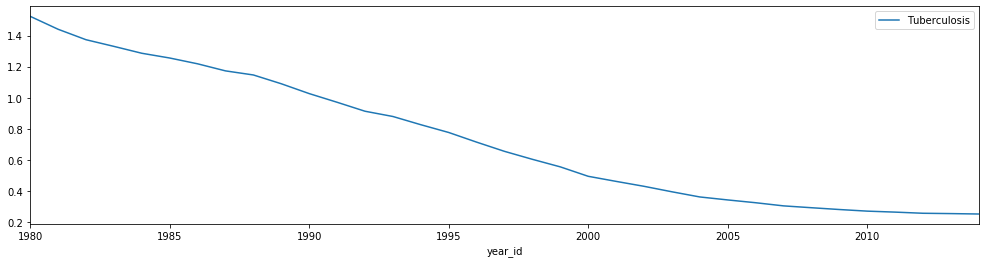

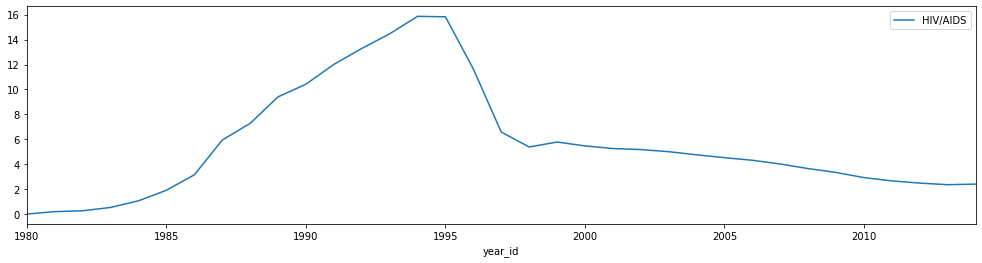

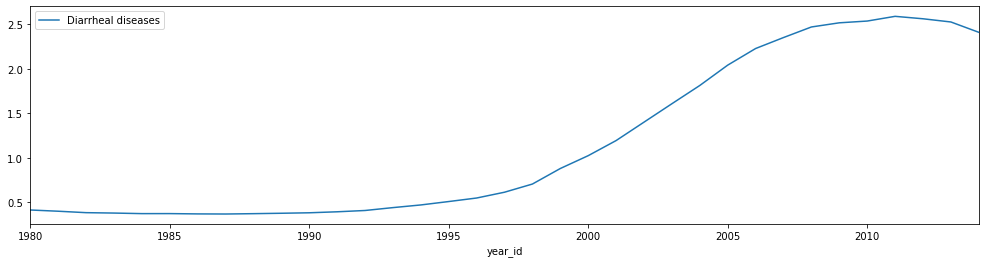

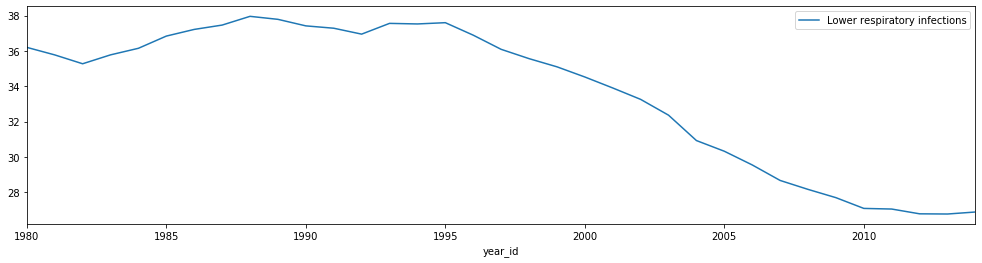

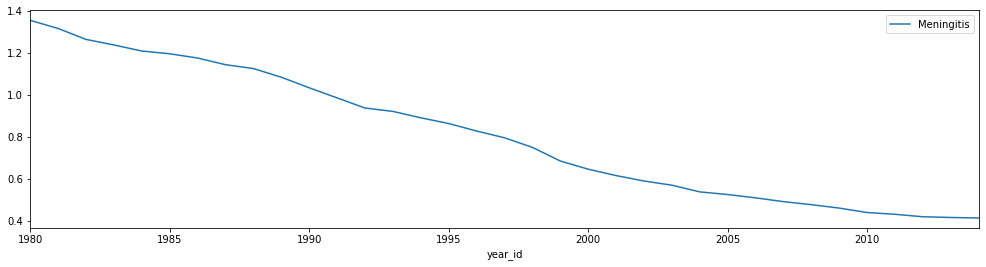

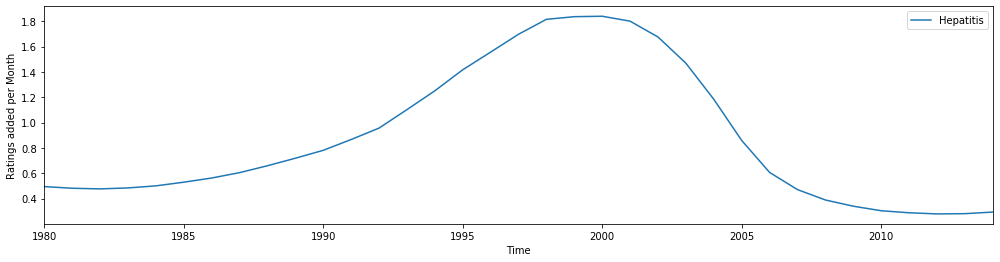

In [ ]:
cat = ['Tuberculosis', 'HIV/AIDS', 'Diarrheal diseases', 'Lower respiratory infections', 'Meningitis', 'Hepatitis']
def plot_mortality(dataset, cat):
    US_data_Tuberculosis = dataset.loc[(dataset['cause_name'] == cat) & (dataset['sex'] == 'Both')]
    US_data_Tuberculosis.plot('year_id', 'mx', label = cat, figsize=(17, 4))

[plot_mortality(US_data, x) for x in cat]
plt.legend()
plt.xlabel('Time')
plt.ylabel('Ratings added per Month')
plt.show()

The three diseases of Tuberculosis, Lower respiratory infections, and Meningitis all decreased with negative slope from 1980 to 2014. However, HIV/AIDS and Diarrheal diseases increased during this period. Both Hepatitis and HIV reached a pick in the middle and the then were reduced.

## 3.3 Show the overall mortality rate split by gender (your plot should have 2 lines, one for each reported gender)

Like the previous one here I have applied a similar fucntion that would plot for both Male and Female seperately for all the diseases from the year 1980 to 2014 for the whole USA

### Tuberculosis

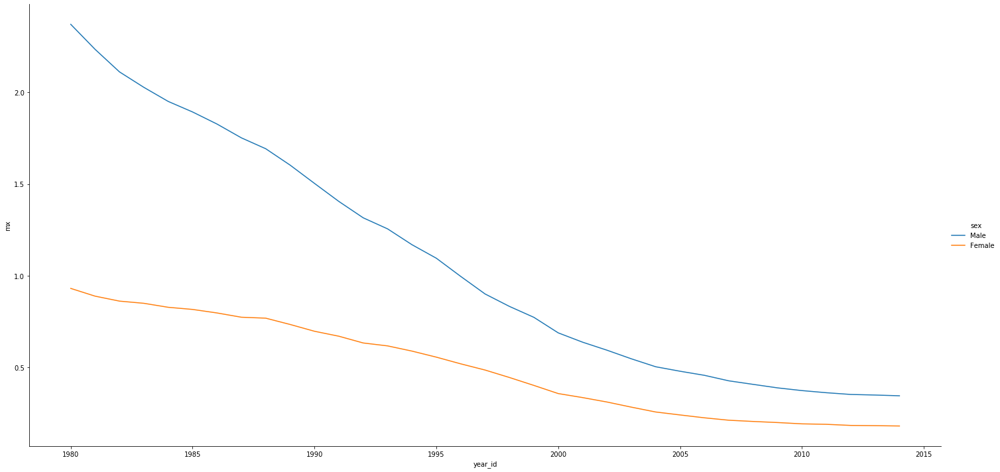

In [ ]:
def plot_both(dataset, name):
    US_data_Tuberculosis = dataset.loc[(dataset['cause_name'] == name) & (dataset['sex'] != 'Both')]
    sns.relplot(x='year_id', y='mx', kind="line", hue="sex", data=US_data_Tuberculosis, aspect=2, height=10)
    
plot_both(US_data, 'Tuberculosis')  

### HIV/AIDS

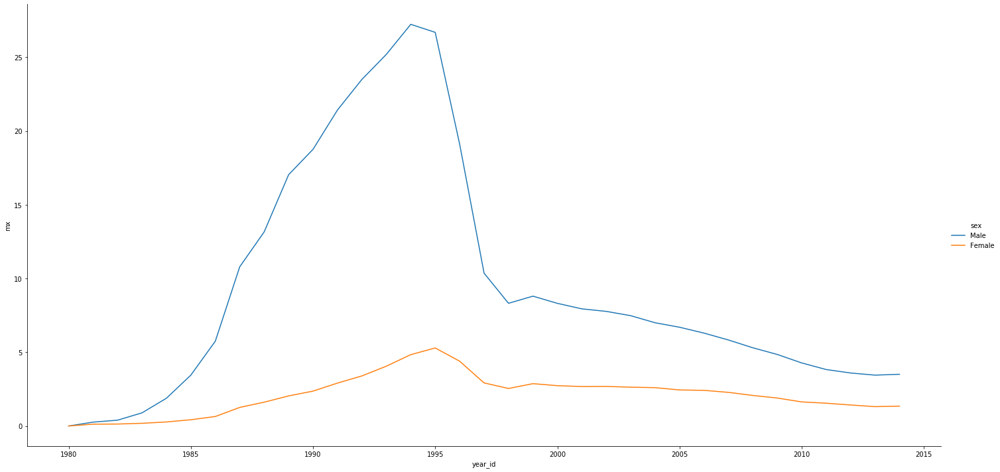

In [ ]:
plot_both(US_data, 'HIV/AIDS')  

### Diarrheal diseases

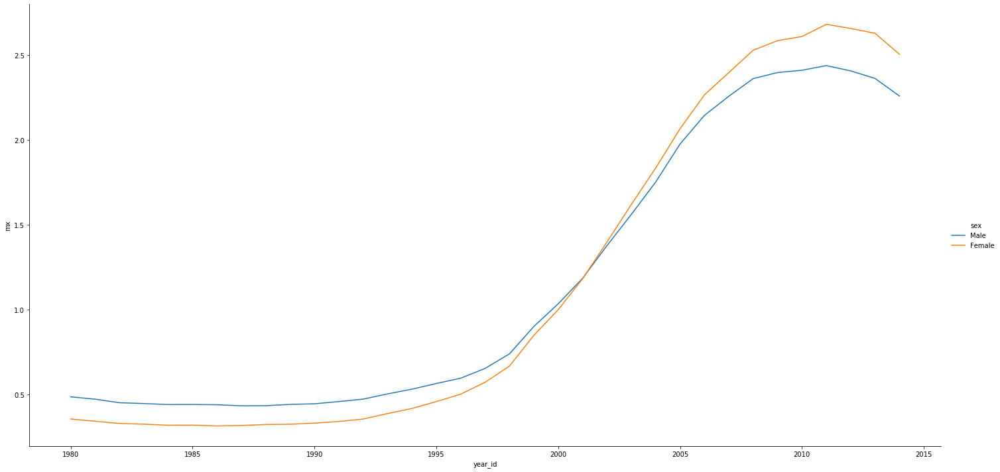

In [ ]:
plot_both(US_data, 'Diarrheal diseases')   

### Lower respiratory infections

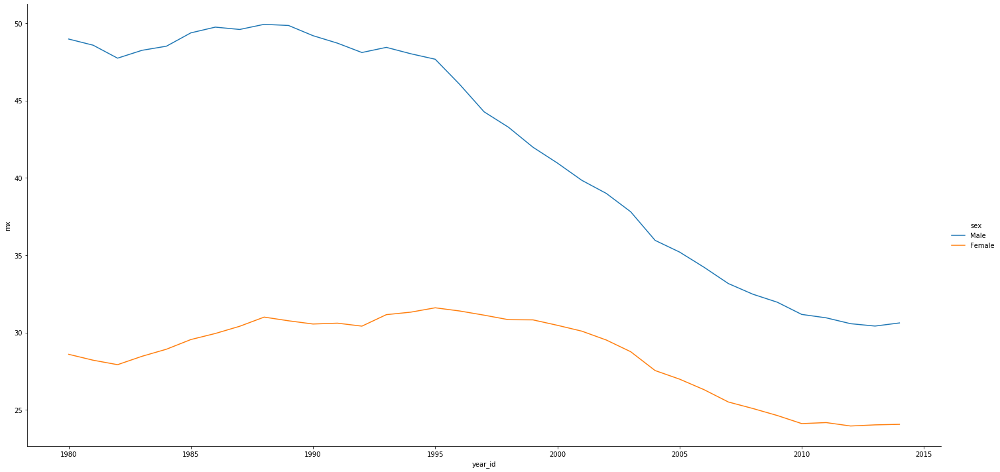

In [ ]:
plot_both(US_data, 'Lower respiratory infections') 

### Meningitis

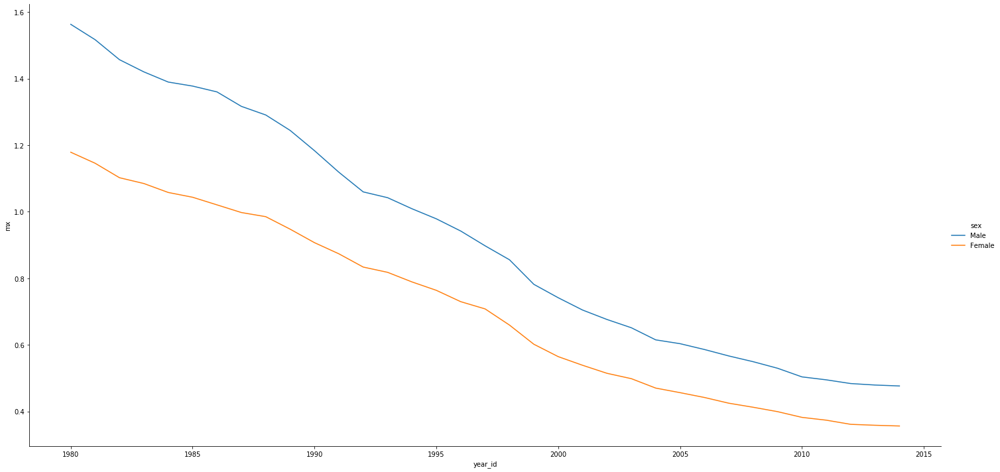

In [ ]:
plot_both(US_data, 'Meningitis') 

### Hepatitis

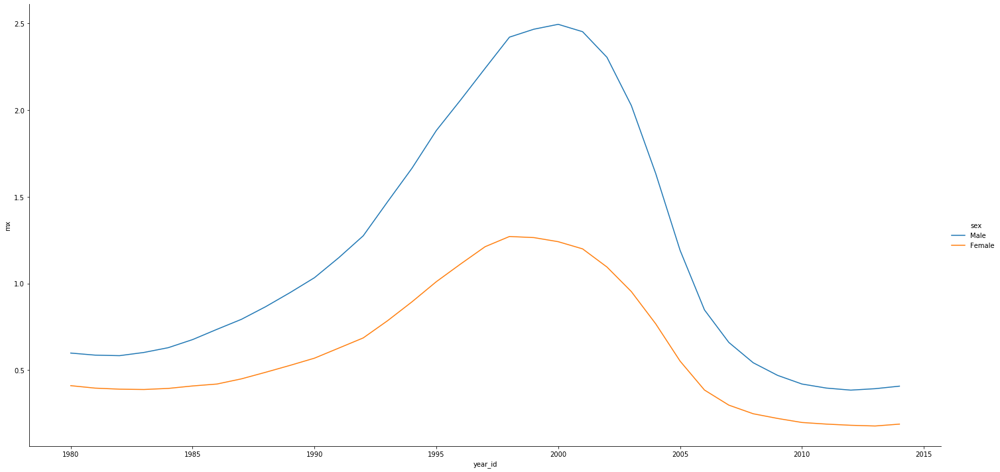

In [ ]:
plot_both(US_data, 'Hepatitis') 

Here for Lower respiratory infections, tuberculosis and meningitis in both male and female the mortality rate decreased whereas it increased for Diarrheal disease

# 4. Modeling Relationships

Lets load the state and County level Mortality data again for convenience 

##  States mortality rate dataset

In [ ]:
state_Mort_rate = Mort_rate[Mort_rate['FIPS']<80]
state_Mort_rate.head()

,measure_id,measure_name,location_id,location_name,FIPS,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper
0,1,Deaths,523,Alabama,1.0,297,Tuberculosis,1,Male,27,Age-standardized,1980,Rate,2.359759,2.094300,2.638586
14341,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2006,Rate,2.237022,1.022623,2.486914
14342,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2007,Rate,2.274337,0.994550,2.528656
14343,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2008,Rate,2.453514,0.988253,2.730467
14344,1,Deaths,523,Alabama,1.0,302,Diarrheal diseases,2,Female,27,Age-standardized,2009,Rate,2.474892,0.974789,2.749556


## Counties mortality rate dataset

For the counties I have concerted the FIPS code to state-county which can indicate both state and county simultaneosuly

In [ ]:
county_Mort_rate = Mort_rate[Mort_rate['FIPS']>100]
county_Mort_rate.head()
county_Mort_rate.rename(columns={'FIPS': 'state-county'}, inplace=True)
county_Mort_rate = county_Mort_rate.assign(FIPS = county_Mort_rate['state-county'] // 1000)
county_Mort_rate.head()

,measure_id,measure_name,location_id,location_name,state-county,cause_id,cause_name,sex_id,sex,age_id,age_name,year_id,metric,mx,lower,upper,FIPS
21550,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2005,Rate,42.565059,36.635814,49.088818,1.0
21551,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2006,Rate,39.247843,33.627375,45.366478,1.0
21553,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2008,Rate,40.594734,34.977506,46.940896,1.0
21554,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2009,Rate,38.989043,33.185272,45.327352,1.0
21559,1,Deaths,614,Autauga County,1001.0,322,Lower respiratory infections,1,Male,27,Age-standardized,2014,Rate,41.752309,35.745240,48.245912,1.0


# The following works are for Lower respiratory

## For States

### 4.1.1 Total population

Lets select the mortality data for year 2014, both gender and the specified disease

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Lower respiratory infections') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,37.393408
Alaska,17.639234
Arizona,18.021531
Arkansas,38.644030
California,20.695523


Merging population and mortality data

In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.000000,-0.010949
total population,-0.010949,1.000000


Renaming columns

In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

Lets plot the relationship between the two variables

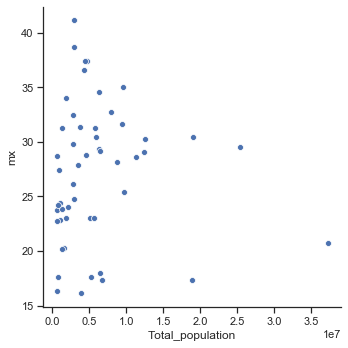

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

The variables are not correlated at all

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.020
Method:                 Least Squares   F-statistic:                  0.005875
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.939
Time:                        23:36:09   Log-Likelihood:                -874.33
No. Observations:                  51   AIC:                             1753.
Df Residuals:                      49   BIC:                             1757.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   6.314e+06   4.33e+06      1.460      0.151   -2.38e+06     1.5e+07
mx          -1.19e+04   1.55e+05     -0.077      0.939   -3.24e+05       3e+05
==============================================================================
Omnibus:                       48.337   Durbin-Watson:                   2.168
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              191.993
Skew:                           2.596   Prob(JB):                     2.04e-42
Kurtosis:                      10.962   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r squared value is close to zero which also indicated the variables are not well related

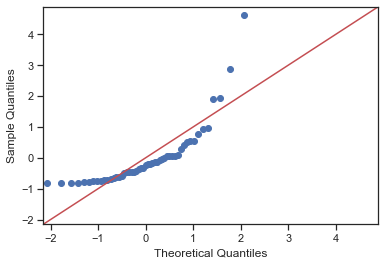

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

 if the two sets come from a population with the same distribution, the points should fall approximately along with the 45 degree reference line, since the data is way distanced than the reference line they are not from the same distribution

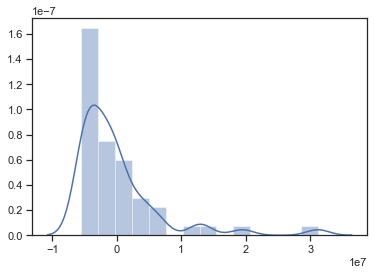

In [ ]:
sns.distplot(lin_pl_state.resid)

The residuals are right skewed

Text(0, 0.5, 'Residuals')

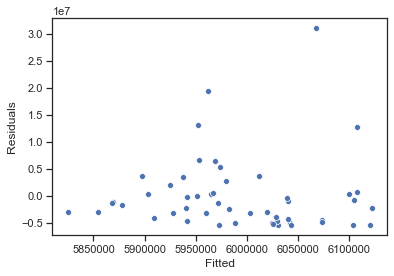

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

We have some values where the variance is high, probably its becuase of the outliers

### 4.1.2 Fraction of the population below the poverty line (state)

Lets make a copy of the previously selected (for both gender and year 2014) population datset

In [ ]:
ss = s_df_pop
ss.head()

,B00001_001E,total population,population under poverty,NAME,FIPS
0,399744,4687615.0,1294017.0,Alabama,01
1,95089,699593.0,114151.0,Alaska,02
2,454290,6399873.0,1711028.0,Arizona,04
3,242391,2857966.0,815516.0,Arkansas,05
4,2749907,37243757.0,9127115.0,California,06


Next we divide the population (C27017_002E) that is under the population thresold 1.38 and divide it by the total population (C27017_001E)

In [ ]:
ss['FracPopUndPov'] = ss['population under poverty'] / ss['total population']
ss.head()

,B00001_001E,total population,population under poverty,NAME,FIPS,FracPopUndPov
0,399744,4687615.0,1294017.0,Alabama,01,0.276050
1,95089,699593.0,114151.0,Alaska,02,0.163168
2,454290,6399873.0,1711028.0,Arizona,04,0.267353
3,242391,2857966.0,815516.0,Arkansas,05,0.285348
4,2749907,37243757.0,9127115.0,California,06,0.245064


Lets look at the correlation betn franction of population under poverty and state level mortality rates 

In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,0.396204
FracPopUndPov,0.396204,1.000000


It doesnt have  a very good correlation but better than the total population

Lets plot the reltionship betn above two variables

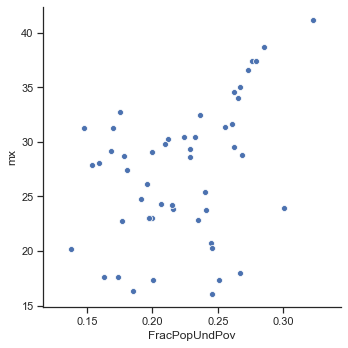

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

It has better correlation on the top portion not so well on the bottom portion

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.157
Model:                            OLS   Adj. R-squared:                  0.140
Method:                 Least Squares   F-statistic:                     9.124
Date:                Sun, 13 Oct 2019   Prob (F-statistic):            0.00400
Time:                        23:36:10   Log-Likelihood:                 92.429
No. Observations:                  51   AIC:                            -180.9
Df Residuals:                      49   BIC:                            -177.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1472      0.025      5.816      0.000       0.096       0.198
mx             0.0027      0.001      3.021      0.004       0.001       0.005
==============================================================================
Omnibus:                        0.686   Durbin-Watson:                   1.972
Prob(Omnibus):                  0.710   Jarque-Bera (JB):                0.775
Skew:                          -0.147   Prob(JB):                        0.679
Kurtosis:                       2.472   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The R squared value shows that model doesnt fit well since its very less that 1

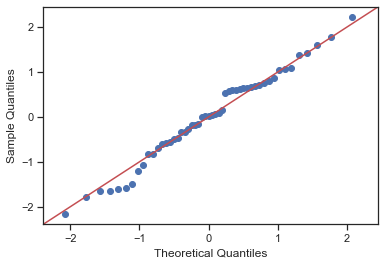

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

The q-q plot shows that the points doesnt fall exactly on the reference line

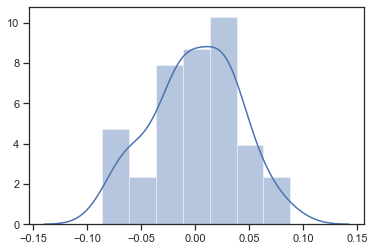

In [ ]:
sns.distplot(lin_pl_state_2.resid)

The residual is almost normally distributed

Text(0, 0.5, 'Residuals')

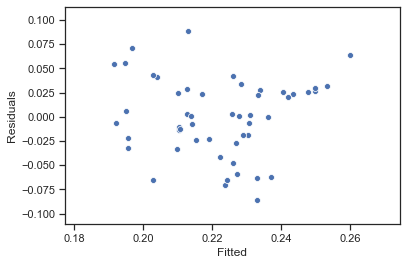

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

The residual value is not close to zero, its scattered, so teh model doesnt fit the relationship well

### 4.1.3 Fraction of the population with health insurance coverage for state - Lower respiratory infections

In our dataset we have 4 (Under 1.38 of poverty threshold, 1.38 to 1.99 of poverty threshold, 2.00 to 3.99 of poverty threshold, 4.00 of poverty threshold and over) different poverty thresold which is again classified on three age categories, below 18, 18-64, and 65+

All this age has two types of data, population with health insurance or without health insurance

So for calculating the fraction of population with health insuarnce I summed for all three age limits within that poverty thresold (under 1.38) and divided it by the total population that is under 1.38 thresold, thats how I calculated the fraction of population with health insurance coverage

In [ ]:
s_hi_pop = c.acs.state(('NAME','C27017_002E','C27017_004E','C27017_007E','C27017_010E'),'*', year=2014)
#trial.head()
s_hi_pop_df = pd.DataFrame(s_hi_pop)
s_hi_pop_df.rename(columns={
    'state': 'FIPS'
    ,'C27017_002E':'total population'  #here we have changed the total population to total population under poverty line that means selecting C27017_002E instead of the C27017_001E as total population
    ,'C27017_004E':'population_hi_18'
    ,'C27017_007E':'population_hi_64'
    ,'C27017_010E':'population_hi_65'}, inplace=True)
s_hi_pop_df.head()

,total population,population_hi_18,population_hi_64,population_hi_65,NAME,FIPS
0,1294017.0,78638.0,234242.0,61355.0,Alabama,01
1,114151.0,8073.0,15758.0,2250.0,Alaska,02
2,1711028.0,101064.0,240028.0,58302.0,Arizona,04
3,815516.0,33349.0,127194.0,36735.0,Arkansas,05
4,9127115.0,528464.0,1386613.0,240774.0,California,06


As discussed above summing up the population with health insurance for all the age categories of population below the 1.38 thresold

In [ ]:
s_hi_pop_df['PopWHeaIns_1_38'] = (s_hi_pop_df['population_hi_18'] + s_hi_pop_df['population_hi_64'] +s_hi_pop_df['population_hi_65'] )/ s_hi_pop_df['total population']
s_hi_pop_df.head()

,total population,population_hi_18,population_hi_64,population_hi_65,NAME,FIPS,PopWHeaIns_1_38
0,1294017.0,78638.0,234242.0,61355.0,Alabama,01,0.289204
1,114151.0,8073.0,15758.0,2250.0,Alaska,02,0.228478
2,1711028.0,101064.0,240028.0,58302.0,Arizona,04,0.233423
3,815516.0,33349.0,127194.0,36735.0,Arkansas,05,0.241906
4,9127115.0,528464.0,1386613.0,240774.0,California,06,0.236203


merging the fraction of population with health insurance coverage with the mortality rate dataset

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.199459
PopWHeaIns_1_38,-0.199459,1.000000


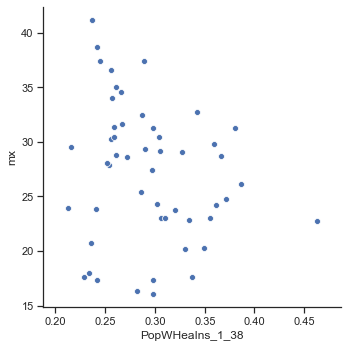

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

The above variables doesnt correlate well which is visble both from plot and the correlation value

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.040
Model:                            OLS   Adj. R-squared:                  0.020
Method:                 Least Squares   F-statistic:                     2.030
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.161
Time:                        23:36:12   Log-Likelihood:                 80.245
No. Observations:                  51   AIC:                            -156.5
Df Residuals:                      49   BIC:                            -152.6
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3385      0.032     10.529      0.000       0.274       0.403
mx            -0.0016      0.001     -1.425      0.161      -0.004       0.001
==============================================================================
Omnibus:                        6.159   Durbin-Watson:                   1.903
Prob(Omnibus):                  0.046   Jarque-Bera (JB):                5.053
Skew:                           0.694   Prob(JB):                       0.0799
Kurtosis:                       3.670   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r squared value is very low, so the model doesnt fits well 

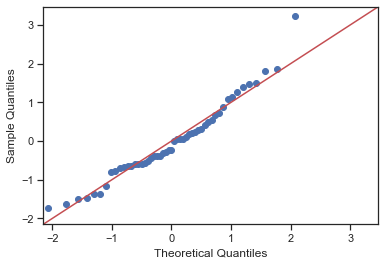

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

The residual mostly fit well with the reference line with some extreme distance at the begining and the end

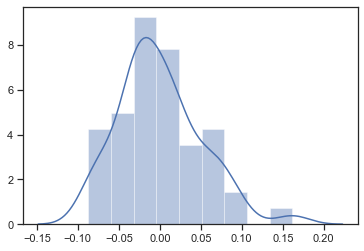

In [ ]:
sns.distplot(lin_pl_state_3.resid)

The residual plot is close to normal distribution

Text(0, 0.5, 'Residuals')

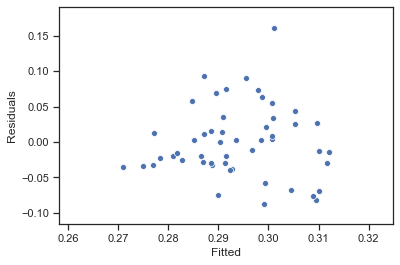

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

Since the residual plot is scattered all around this is also a evidence that the model doesnt fit well

## 4.2 County

### 4.2.1 Total population

Like the state one lets select the count level mortality data for Lower respiratory infections for the year 2014 for both gender class

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Lower respiratory infections') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,34.153983
1003.0,21.820851
1005.0,33.954553
1007.0,41.295744
1009.0,54.023856


In [ ]:
c_df_pop.head()

,B00001_001E,total population,population under poverty,NAME,county,FIPS
0,751076,9815811.0,2724570.0,"Los Angeles County, California",037,06
1,10180,143740.0,50284.0,"Madera County, California",039,06
2,18102,249456.0,31489.0,"Marin County, California",041,06
3,1315,17771.0,3945.0,"Mariposa County, California",043,06
4,6649,86021.0,26668.0,"Mendocino County, California",045,06


Converting the county datas FIPS(for state) and county code to integer and later adding them together to have a FIPS code which can indicate both state and county(the same format from the total population dataset), which would be required later to merge with the mortality datasets 

In [ ]:
c_df_pop['FIPS'] = c_df_pop['FIPS'].astype(int)
c_df_pop['FIPS_county'] = c_df_pop['county'].astype(int)
c_df_pop.head()

,B00001_001E,total population,population under poverty,NAME,county,FIPS,FIPS_county
0,751076,9815811.0,2724570.0,"Los Angeles County, California",037,6,37
1,10180,143740.0,50284.0,"Madera County, California",039,6,39
2,18102,249456.0,31489.0,"Marin County, California",041,6,41
3,1315,17771.0,3945.0,"Mariposa County, California",043,6,43
4,6649,86021.0,26668.0,"Mendocino County, California",045,6,45


In [ ]:
c_df_pop['FIPS_new'] = c_df_pop['FIPS'].multiply(1000) + c_df_pop['FIPS_county']
c_df_pop.head()

,B00001_001E,total population,population under poverty,NAME,county,FIPS,FIPS_county,FIPS_new
0,751076,9815811.0,2724570.0,"Los Angeles County, California",037,6,37,6037
1,10180,143740.0,50284.0,"Madera County, California",039,6,39,6039
2,18102,249456.0,31489.0,"Marin County, California",041,6,41,6041
3,1315,17771.0,3945.0,"Mariposa County, California",043,6,43,6043
4,6649,86021.0,26668.0,"Mendocino County, California",045,6,45,6045


Lets merge both the dataset again to later see teh correlationship

In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,34.153983,54156.0,1001
1,21.820851,188357.0,1003
2,33.954553,24215.0,1005
3,41.295744,21095.0,1007
4,54.023856,57052.0,1009


Dropping FIPS column

In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.000000,-0.098662
total population,-0.098662,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

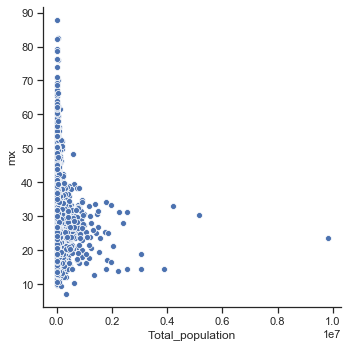

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

The correlation plot shows the values are close to zero on the x axis with higher values on the y axis, so the variables doesnt correlate well whcih is also evidence from the correlation value

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     30.85
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           3.03e-08
Time:                        23:36:13   Log-Likelihood:                -44186.
No. Observations:                3140   AIC:                         8.838e+04
Df Residuals:                    3138   BIC:                         8.839e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.896e+05   1.75e+04     10.812      0.000    1.55e+05    2.24e+05
mx         -3045.9989    548.441     -5.554      0.000   -4121.339   -1970.659
==============================================================================
Omnibus:                     5987.482   Durbin-Watson:                   1.855
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         15538824.390
Skew:                          14.326   Prob(JB):                         0.00
Kurtosis:                     346.434   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r squared value is very small, close to zero which also indicated the variables doesnt correlate well

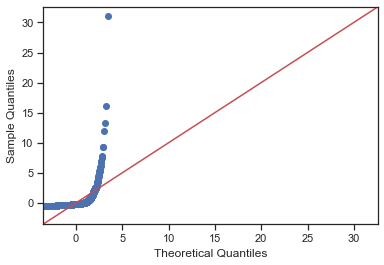

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

The values doesnt fit teh reerence line at all indicating the two data sets have come from populations with different distributions

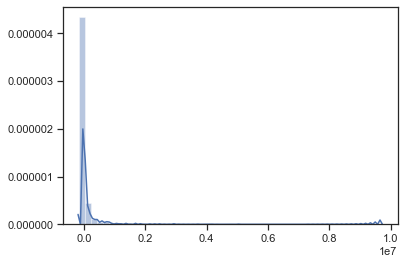

In [ ]:
sns.distplot(lin_pl_county.resid)

The resiudal has most of the values on the left portion

Text(0, 0.5, 'Residuals')

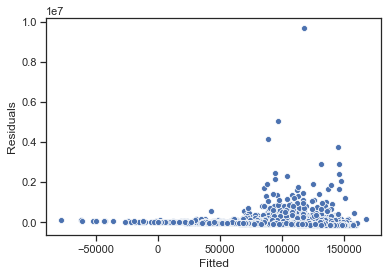

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

On the right hand side of the plot we have residulas with higher variances

### 4.2.2 Fraction of the population below the poverty line (county)

Like teh state one here I have taken the total population (C27017_002E) that is under 1.38 thresold and divided it by the varible "total" (C27017_001E) to calculate the population below teh poverty line  

In [ ]:
ss_county = c_df_pop
ss_county['FracPopUndPov'] = ss_county['population under poverty'] / ss_county['total population']
ss_county.head()

,B00001_001E,total population,population under poverty,NAME,county,FIPS,FIPS_county,FIPS_new,FracPopUndPov
0,751076,9815811.0,2724570.0,"Los Angeles County, California",037,6,37,6037,0.277570
1,10180,143740.0,50284.0,"Madera County, California",039,6,39,6039,0.349826
2,18102,249456.0,31489.0,"Marin County, California",041,6,41,6041,0.126231
3,1315,17771.0,3945.0,"Mariposa County, California",043,6,43,6043,0.221991
4,6649,86021.0,26668.0,"Mendocino County, California",045,6,45,6045,0.310017


In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.479325
FracPopUndPov,0.479325,1.000000


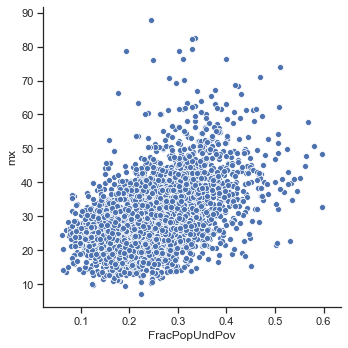

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

The correlation value and the plot shows that it is better correlated than the others we have seen so far

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.230
Model:                            OLS   Adj. R-squared:                  0.230
Method:                 Least Squares   F-statistic:                     936.0
Date:                Sun, 13 Oct 2019   Prob (F-statistic):          3.94e-180
Time:                        23:36:14   Log-Likelihood:                 3768.9
No. Observations:                3140   AIC:                            -7534.
Df Residuals:                    3138   BIC:                            -7522.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1349      0.004     33.018      0.000       0.127       0.143
mx             0.0039      0.000     30.594      0.000       0.004       0.004
==============================================================================
Omnibus:                      120.590   Durbin-Watson:                   1.541
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              155.042
Skew:                           0.411   Prob(JB):                     2.15e-34
Kurtosis:                       3.713   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

The r squared value is higher than the previous than the previous plots (although still low) it indicates the variables are better correlated

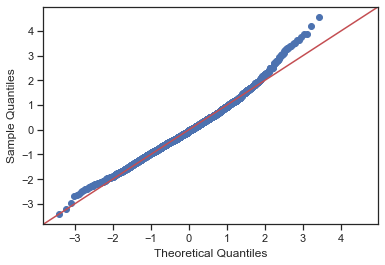

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

Since the correlation is better compared to the previous one, as expected in the q-q plot the values follows the reference line for most of teh portion

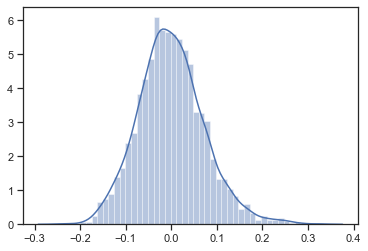

In [ ]:
sns.distplot(lin_pl_county.resid)

The residual plot almost follows a normal distribution

Text(0, 0.5, 'Residuals')

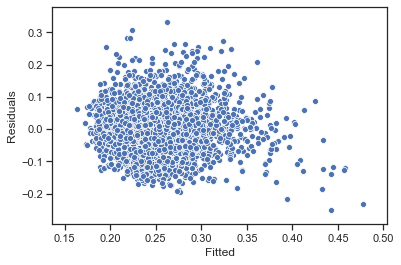

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

The residuals are more conjusted towrds the center

### 4.2.3 Fraction of the population with health insurance coverage for county - Lower respiratory infections

Like the state one here I have here I have selected the variables for all the three age categories (<18, 18-64, 65+) for teh people that have health insurance under the poverty thresold of 1.38

In [ ]:
#c_hi_pop = c.acs.state(('NAME','C27017_001E','C27017_004E','C27017_007E','C27017_010E'),'*', year=2014)
c_hi_pop = c.acs.state_county(('NAME','C27017_001E','C27017_002E','C27017_004E','C27017_007E','C27017_010E'),'*','*', year=2014)
#trial.head()
#c_hi_pop = c.acs.state_county(('NAME','C27017_001E','C27017_002E','C27017_003E','C27017_004E','C27017_005E','C27017_006E','C27017_009E'),'*','*', year=2014)
#trial.head()
c_hi_pop_df = pd.DataFrame(c_hi_pop)
c_hi_pop_df.rename(columns={
    'state': 'FIPS'
    ,'C27017_001E':'Total_population'
    ,'C27017_002E':'population_under_poverty'
    ,'C27017_004E':'population_hi_18'
    ,'C27017_007E':'population_hi_64'
    ,'C27017_010E':'population_hi_65'}, inplace=True)
c_hi_pop_df.head()

,Total_population,population_under_poverty,population_hi_18,population_hi_64,population_hi_65,NAME,county,FIPS
0,9815811.0,2724570.0,131470.0,365504.0,50915.0,"Los Angeles County, California",037,06
1,143740.0,50284.0,2893.0,4440.0,1319.0,"Madera County, California",039,06
2,249456.0,31489.0,2199.0,7456.0,2267.0,"Marin County, California",041,06
3,17771.0,3945.0,265.0,696.0,319.0,"Mariposa County, California",043,06
4,86021.0,26668.0,1123.0,2841.0,741.0,"Mendocino County, California",045,06


Like previous one the to comapre with the mortality rate dataset we are converting the state FIPS and county FIPS to integer and later adding them to make a FIPS which can indicate both teh state and county for Fraction of the population with health insurance coverage dataset (like the population mortality rate dataset)

In [ ]:
c_hi_pop_df['FIPS'] = c_hi_pop_df['FIPS'].astype(int)
c_hi_pop_df['FIPS_county'] = c_hi_pop_df['county'].astype(int)
c_hi_pop_df['FIPS_new'] = c_hi_pop_df['FIPS'].multiply(1000) + c_hi_pop_df['FIPS_county']
c_hi_pop_df.head()

,Total_population,population_under_poverty,population_hi_18,population_hi_64,population_hi_65,NAME,county,FIPS,FIPS_county,FIPS_new
0,9815811.0,2724570.0,131470.0,365504.0,50915.0,"Los Angeles County, California",037,6,37,6037
1,143740.0,50284.0,2893.0,4440.0,1319.0,"Madera County, California",039,6,39,6039
2,249456.0,31489.0,2199.0,7456.0,2267.0,"Marin County, California",041,6,41,6041
3,17771.0,3945.0,265.0,696.0,319.0,"Mariposa County, California",043,6,43,6043
4,86021.0,26668.0,1123.0,2841.0,741.0,"Mendocino County, California",045,6,45,6045


Summing population having health insuarnce for all ages and dividing that by the population under 1.38 thresold, this time instead of the "total variable " I divided by the total population that is under 1.38 population thresold

In [ ]:
c_hi_pop_df['PopWHeaIns_1_38'] = (c_hi_pop_df['population_hi_18'] + c_hi_pop_df['population_hi_64'] +c_hi_pop_df['population_hi_65'] ) / c_hi_pop_df['population_under_poverty']
c_hi_pop_df.head()

,Total_population,population_under_poverty,population_hi_18,population_hi_64,population_hi_65,NAME,county,FIPS,FIPS_county,FIPS_new,PopWHeaIns_1_38
0,9815811.0,2724570.0,131470.0,365504.0,50915.0,"Los Angeles County, California",037,6,37,6037,0.201092
1,143740.0,50284.0,2893.0,4440.0,1319.0,"Madera County, California",039,6,39,6039,0.172063
2,249456.0,31489.0,2199.0,7456.0,2267.0,"Marin County, California",041,6,41,6041,0.378608
3,17771.0,3945.0,265.0,696.0,319.0,"Mariposa County, California",043,6,43,6043,0.324461
4,86021.0,26668.0,1123.0,2841.0,741.0,"Mendocino County, California",045,6,45,6045,0.176429


In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.357899
PopWHeaIns_1_38,-0.357899,1.000000


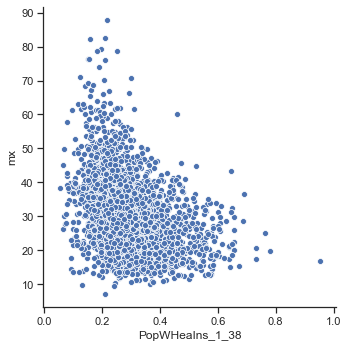

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

The variables are not correlated well visualized both from the plot and correlation value

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.128
Model:                            OLS   Adj. R-squared:                  0.128
Method:                 Least Squares   F-statistic:                     461.0
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.58e-95
Time:                        23:36:16   Log-Likelihood:                 2941.3
No. Observations:                3140   AIC:                            -5879.
Df Residuals:                    3138   BIC:                            -5866.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3999      0.005     75.194      0.000       0.389       0.410
mx            -0.0036      0.000    -21.471      0.000      -0.004      -0.003
==============================================================================
Omnibus:                      488.493   Durbin-Watson:                   1.504
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              976.014
Skew:                           0.943   Prob(JB):                    1.15e-212
Kurtosis:                       4.975   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

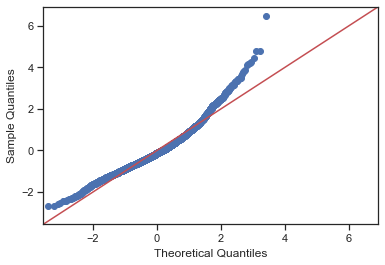

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

The values fits well with the reference line in the middle but not at the begining and teh end

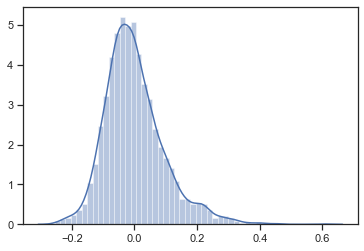

In [ ]:
sns.distplot(lin_pl_county.resid)

The residual plot is almost normally distributed

Text(0, 0.5, 'Residuals')

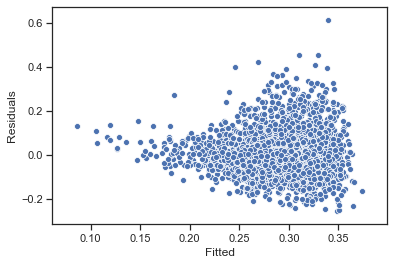

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

The residuals are also have high variances indicating that teh model doesnt fits well

From the above plot its understandable that none of the variabels correlate well for Lower respiratory mortality rate for any paramter Total population, Fraction of the population below the poverty line, Fraction of the population with health insurance coverage at both county and state level. At the county level the Fraction of the population below the poverty line fitted well compared to the others


Lets look at the other diseases if those have any better relationships

Lets look at the other diseases

In [ ]:
Disease = state_Mort_rate['cause_name'].unique()
Disease

array(['Tuberculosis', 'Diarrheal diseases', 'Hepatitis', 'HIV/AIDS',
       'Lower respiratory infections', 'Meningitis'], dtype=object)

So there are 6 disease, we have already done for "Lower respiratory infections", lets do for the other ones, I have repetated the above task for all other diseases

# The following works are for Tuberculosis

## State

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Tuberculosis') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,0.355667
Alaska,0.518633
Arizona,0.258537
Arkansas,0.317000
California,0.327106


In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.000000,0.201176
total population,0.201176,1.000000


In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

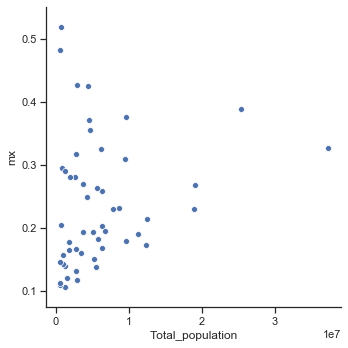

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.040
Model:                            OLS   Adj. R-squared:                  0.021
Method:                 Least Squares   F-statistic:                     2.067
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.157
Time:                        23:36:17   Log-Likelihood:                -873.28
No. Observations:                  51   AIC:                             1751.
Df Residuals:                      49   BIC:                             1754.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   2.779e+06   2.43e+06      1.146      0.257   -2.09e+06    7.65e+06
mx          1.355e+07   9.42e+06      1.438      0.157   -5.39e+06    3.25e+07
==============================================================================
Omnibus:                       43.874   Durbin-Watson:                   2.206
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              154.487
Skew:                           2.354   Prob(JB):                     2.84e-34
Kurtosis:                      10.108   Cond. No.                         10.5
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

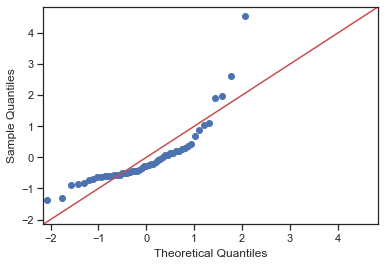

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

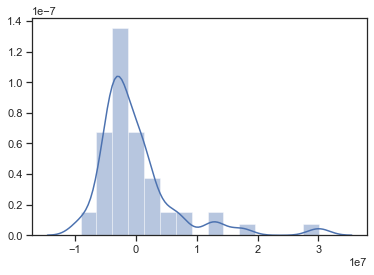

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

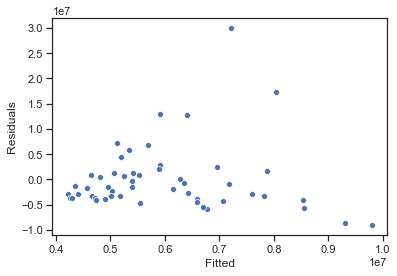

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (state)

In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,0.468047
FracPopUndPov,0.468047,1.000000


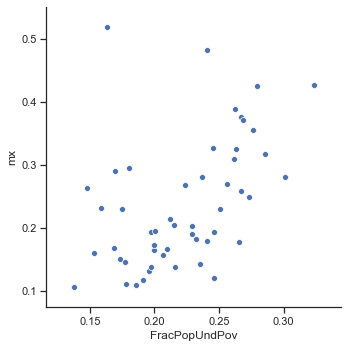

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.219
Model:                            OLS   Adj. R-squared:                  0.203
Method:                 Least Squares   F-statistic:                     13.75
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           0.000533
Time:                        23:36:18   Log-Likelihood:                 94.380
No. Observations:                  51   AIC:                            -184.8
Df Residuals:                      49   BIC:                            -180.9
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1742      0.014     12.487      0.000       0.146       0.202
mx             0.2009      0.054      3.707      0.001       0.092       0.310
==============================================================================
Omnibus:                        4.889   Durbin-Watson:                   2.139
Prob(Omnibus):                  0.087   Jarque-Bera (JB):                3.912
Skew:                          -0.652   Prob(JB):                        0.141
Kurtosis:                       3.377   Cond. No.                         10.5
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

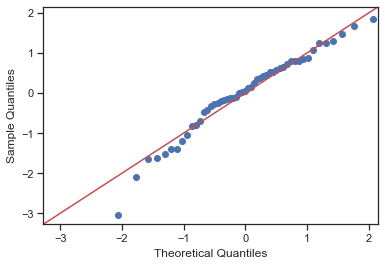

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

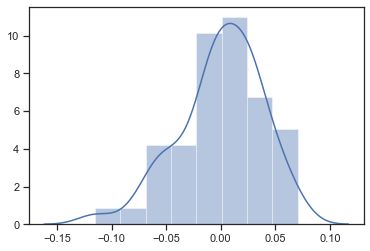

In [ ]:
sns.distplot(lin_pl_state_2.resid)

Text(0, 0.5, 'Residuals')

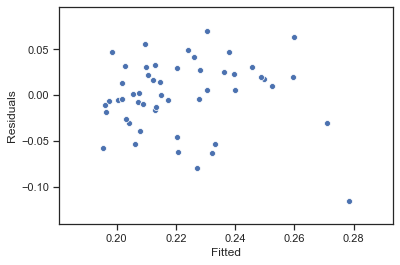

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population with health insurance coverage for state - Tuberculosis

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.520274
PopWHeaIns_1_38,-0.520274,1.000000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_38,NAME
0,0.355667,0.289204,Alabama
1,0.518633,0.228478,Alaska
2,0.258537,0.233423,Arizona
3,0.317000,0.241906,Arkansas
4,0.327106,0.236203,California


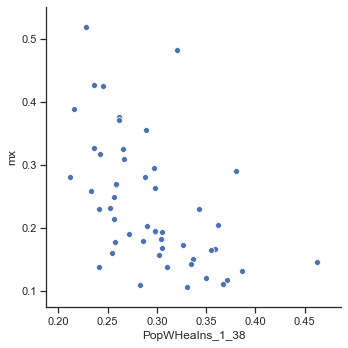

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.271
Model:                            OLS   Adj. R-squared:                  0.256
Method:                 Least Squares   F-statistic:                     18.19
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           9.10e-05
Time:                        23:36:18   Log-Likelihood:                 87.259
No. Observations:                  51   AIC:                            -170.5
Df Residuals:                      49   BIC:                            -166.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3569      0.016     22.252      0.000       0.325       0.389
mx            -0.2658      0.062     -4.265      0.000      -0.391      -0.141
==============================================================================
Omnibus:                        9.704   Durbin-Watson:                   2.144
Prob(Omnibus):                  0.008   Jarque-Bera (JB):                9.273
Skew:                           0.867   Prob(JB):                      0.00969
Kurtosis:                       4.164   Cond. No.                         10.5
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

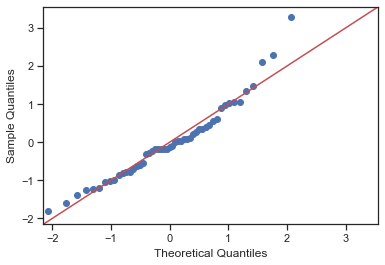

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

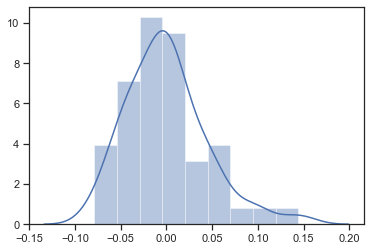

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

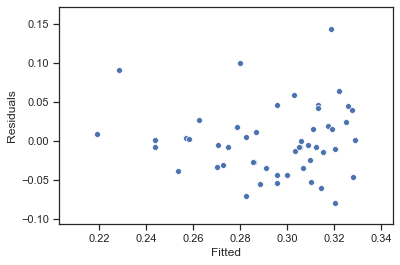

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Tuberculosis') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,0.309921
1003.0,0.197299
1005.0,0.416175
1007.0,0.261805
1009.0,0.258540


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,0.309921,54156.0,1001
1,0.197299,188357.0,1003
2,0.416175,24215.0,1005
3,0.261805,21095.0,1007
4,0.258540,57052.0,1009


In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.000000,0.094686
total population,0.094686,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

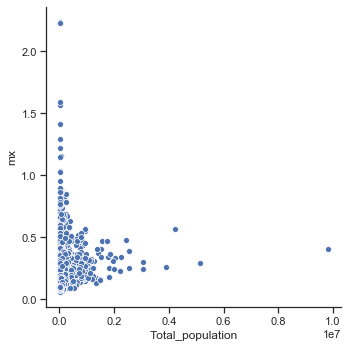

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.009
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     28.39
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.06e-07
Time:                        23:36:19   Log-Likelihood:                -44187.
No. Observations:                3140   AIC:                         8.838e+04
Df Residuals:                    3138   BIC:                         8.839e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.632e+04   9504.146      5.926      0.000    3.77e+04     7.5e+04
mx          1.897e+05   3.56e+04      5.328      0.000     1.2e+05    2.59e+05
==============================================================================
Omnibus:                     5972.341   Durbin-Watson:                   1.835
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         15287294.670
Skew:                          14.248   Prob(JB):                         0.00
Kurtosis:                     343.637   Cond. No.                         6.68
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

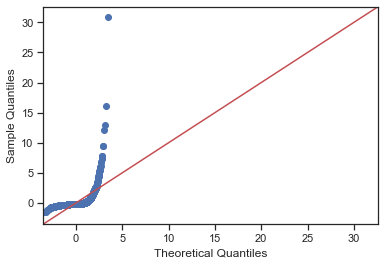

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

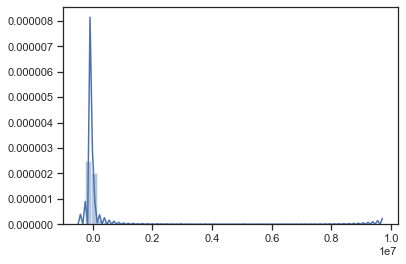

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

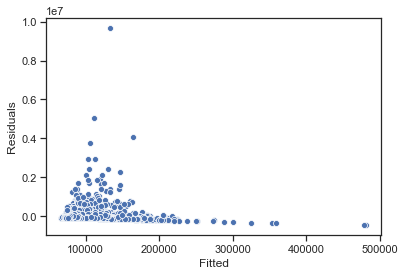

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population below the poverty line (county)

In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.548437
FracPopUndPov,0.548437,1.000000


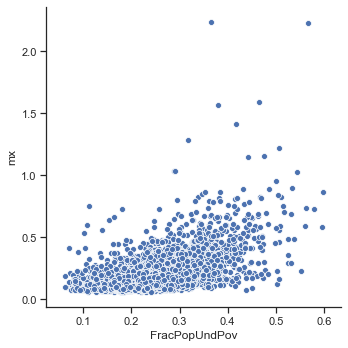

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.301
Model:                            OLS   Adj. R-squared:                  0.301
Method:                 Least Squares   F-statistic:                     1350.
Date:                Sun, 13 Oct 2019   Prob (F-statistic):          4.08e-246
Time:                        23:36:20   Log-Likelihood:                 3920.8
No. Observations:                3140   AIC:                            -7838.
Df Residuals:                    3138   BIC:                            -7826.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1907      0.002     90.441      0.000       0.187       0.195
mx             0.2902      0.008     36.741      0.000       0.275       0.306
==============================================================================
Omnibus:                       99.024   Durbin-Watson:                   1.495
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              263.024
Skew:                           0.022   Prob(JB):                     7.67e-58
Kurtosis:                       4.417   Cond. No.                         6.68
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

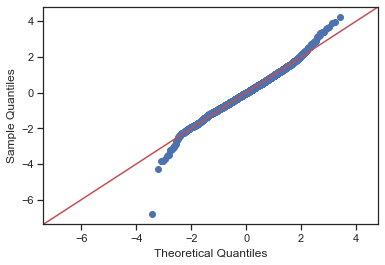

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

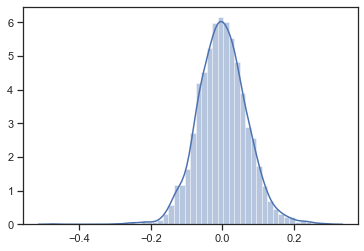

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

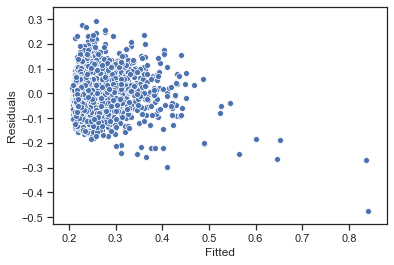

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for county - Tuberculosis

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.419782
PopWHeaIns_1_38,-0.419782,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_38,FIPS_new
0,0.309921,0.381169,1001
1,0.197299,0.301172,1003
2,0.416175,0.217912,1005
3,0.261805,0.311698,1007
4,0.258540,0.287661,1009


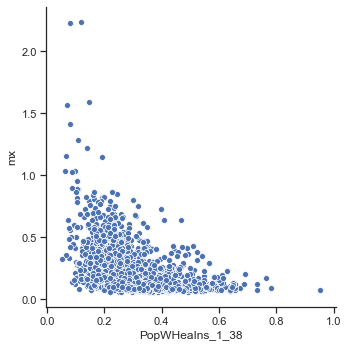

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.176
Model:                            OLS   Adj. R-squared:                  0.176
Method:                 Least Squares   F-statistic:                     671.3
Date:                Sun, 13 Oct 2019   Prob (F-statistic):          2.75e-134
Time:                        23:36:21   Log-Likelihood:                 3030.4
No. Observations:                3140   AIC:                            -6057.
Df Residuals:                    3138   BIC:                            -6045.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3504      0.003    125.116      0.000       0.345       0.356
mx            -0.2718      0.010    -25.909      0.000      -0.292      -0.251
==============================================================================
Omnibus:                      608.020   Durbin-Watson:                   1.556
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1347.111
Skew:                           1.104   Prob(JB):                    3.01e-293
Kurtosis:                       5.328   Cond. No.                         6.68
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

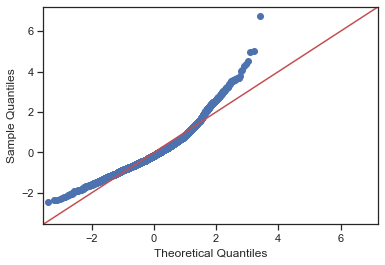

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

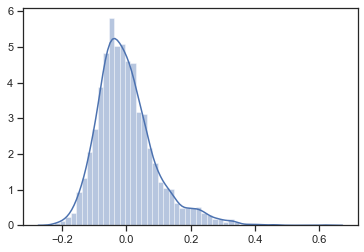

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

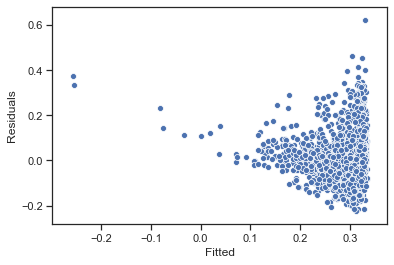

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

# The following works are for HIV/AIDS


## State

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='HIV/AIDS') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,2.585321
Alaska,0.749104
Arizona,1.564535
Arkansas,1.786682
California,2.142319


In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.00000,0.12944
total population,0.12944,1.00000


In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

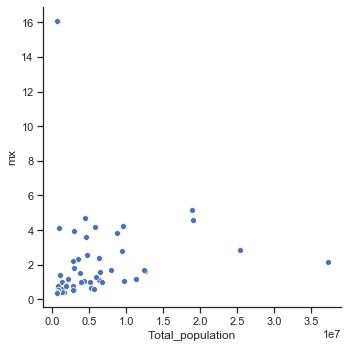

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.017
Model:                            OLS   Adj. R-squared:                 -0.003
Method:                 Least Squares   F-statistic:                    0.8350
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.365
Time:                        23:36:22   Log-Likelihood:                -873.91
No. Observations:                  51   AIC:                             1752.
Df Residuals:                      49   BIC:                             1756.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.244e+06   1.26e+06      4.171      0.000    2.72e+06    7.77e+06
mx           3.65e+05   3.99e+05      0.914      0.365   -4.38e+05    1.17e+06
==============================================================================
Omnibus:                       48.171   Durbin-Watson:                   2.173
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              199.424
Skew:                           2.550   Prob(JB):                     4.96e-44
Kurtosis:                      11.236   Cond. No.                         4.33
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

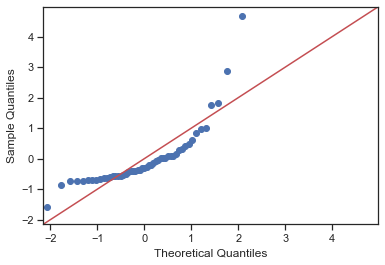

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

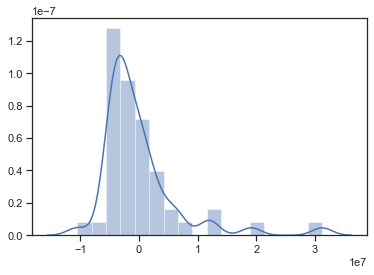

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

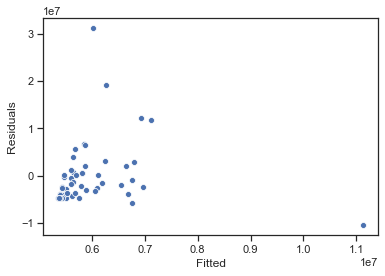

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (state)


In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,0.207709
FracPopUndPov,0.207709,1.000000


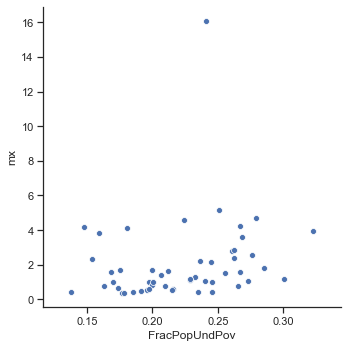

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.043
Model:                            OLS   Adj. R-squared:                  0.024
Method:                 Least Squares   F-statistic:                     2.209
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.144
Time:                        23:36:23   Log-Likelihood:                 89.199
No. Observations:                  51   AIC:                            -174.4
Df Residuals:                      49   BIC:                            -170.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.2142      0.008     27.081      0.000       0.198       0.230
mx             0.0037      0.003      1.486      0.144      -0.001       0.009
==============================================================================
Omnibus:                        1.560   Durbin-Watson:                   1.916
Prob(Omnibus):                  0.458   Jarque-Bera (JB):                1.115
Skew:                           0.025   Prob(JB):                        0.573
Kurtosis:                       2.277   Cond. No.                         4.33
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

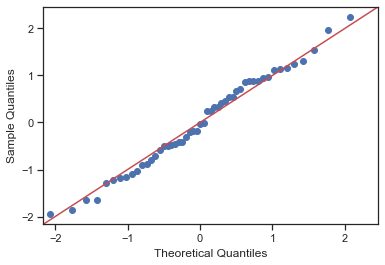

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

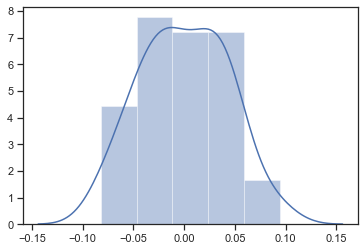

In [ ]:
sns.distplot(lin_pl_state_2.resid)

Text(0, 0.5, 'Residuals')

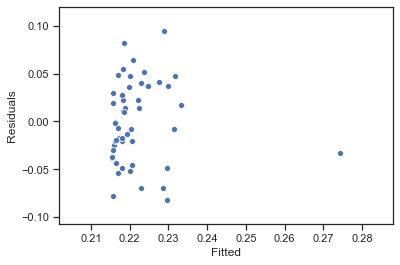

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for state -  HIV/AIDS

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.217896
PopWHeaIns_1_38,-0.217896,1.000000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_38,NAME
0,2.585321,0.289204,Alabama
1,0.749104,0.228478,Alaska
2,1.564535,0.233423,Arizona
3,1.786682,0.241906,Arkansas
4,2.142319,0.236203,California


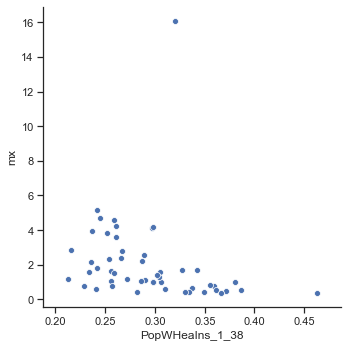

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.047
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     2.442
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.125
Time:                        23:36:23   Log-Likelihood:                 80.451
No. Observations:                  51   AIC:                            -156.9
Df Residuals:                      49   BIC:                            -153.0
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3034      0.009     32.317      0.000       0.285       0.322
mx            -0.0047      0.003     -1.563      0.125      -0.011       0.001
==============================================================================
Omnibus:                        6.393   Durbin-Watson:                   1.975
Prob(Omnibus):                  0.041   Jarque-Bera (JB):                5.392
Skew:                           0.755   Prob(JB):                       0.0675
Kurtosis:                       3.506   Cond. No.                         4.33
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

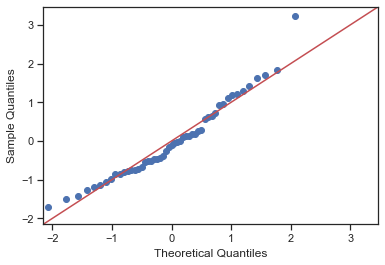

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

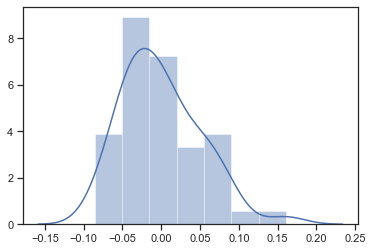

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

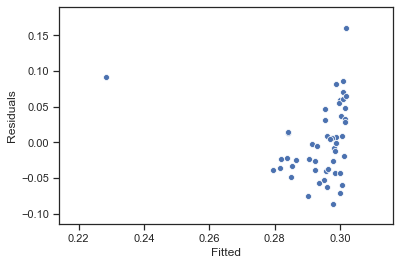

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='HIV/AIDS') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,1.995046
1003.0,1.814896
1005.0,4.030395
1007.0,1.244898
1009.0,1.053874


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,1.995046,54156.0,1001
1,1.814896,188357.0,1003
2,4.030395,24215.0,1005
3,1.244898,21095.0,1007
4,1.053874,57052.0,1009


In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.000000,0.169409
total population,0.169409,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

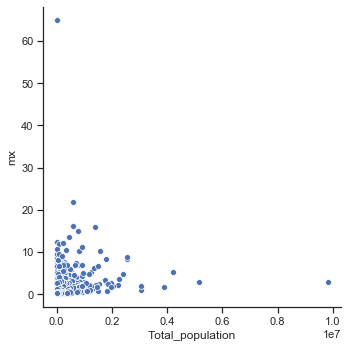

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.029
Model:                            OLS   Adj. R-squared:                  0.028
Method:                 Least Squares   F-statistic:                     92.72
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.20e-21
Time:                        23:36:24   Log-Likelihood:                -44156.
No. Observations:                3140   AIC:                         8.832e+04
Df Residuals:                    3138   BIC:                         8.833e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   6.113e+04   6683.875      9.146      0.000     4.8e+04    7.42e+04
mx          2.714e+04   2818.860      9.629      0.000    2.16e+04    3.27e+04
==============================================================================
Omnibus:                     6002.326   Durbin-Watson:                   1.848
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         16312307.890
Skew:                          14.385   Prob(JB):                         0.00
Kurtosis:                     354.927   Cond. No.                         3.05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

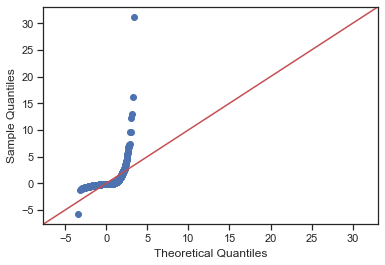

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

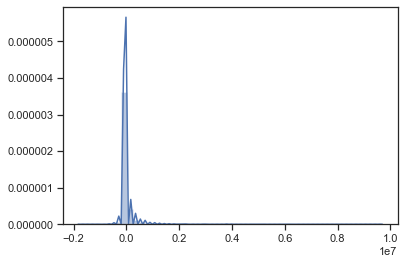

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

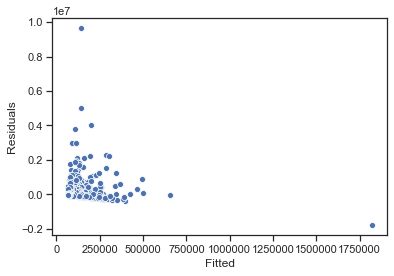

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (county)

In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.332246
FracPopUndPov,0.332246,1.000000


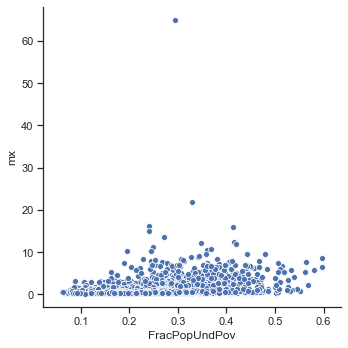

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.110
Model:                            OLS   Adj. R-squared:                  0.110
Method:                 Least Squares   F-statistic:                     389.4
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           8.46e-82
Time:                        23:36:25   Log-Likelihood:                 3542.8
No. Observations:                3140   AIC:                            -7082.
Df Residuals:                    3138   BIC:                            -7069.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.2347      0.002    138.887      0.000       0.231       0.238
mx             0.0141      0.001     19.733      0.000       0.013       0.015
==============================================================================
Omnibus:                      335.832   Durbin-Watson:                   1.486
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             2898.918
Skew:                           0.030   Prob(JB):                         0.00
Kurtosis:                       7.707   Cond. No.                         3.05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

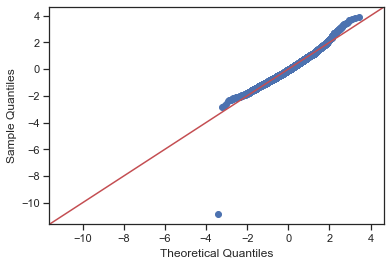

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

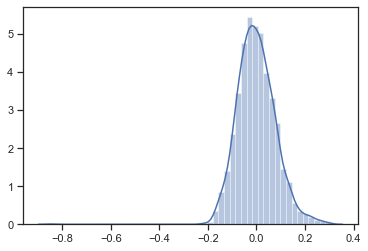

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

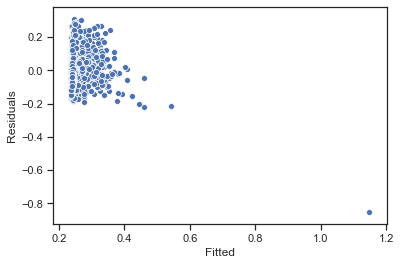

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population with health insurance coverage for county - HIV/AIDS

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.229207
PopWHeaIns_1_38,-0.229207,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_38,FIPS_new
0,1.995046,0.381169,1001
1,1.814896,0.301172,1003
2,4.030395,0.217912,1005
3,1.244898,0.311698,1007
4,1.053874,0.287661,1009


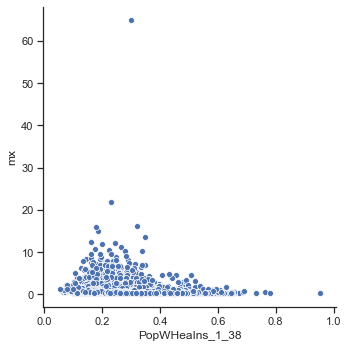

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.053
Model:                            OLS   Adj. R-squared:                  0.052
Method:                 Least Squares   F-statistic:                     174.0
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.04e-38
Time:                        23:36:26   Log-Likelihood:                 2810.8
No. Observations:                3140   AIC:                            -5618.
Df Residuals:                    3138   BIC:                            -5605.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3075      0.002    144.126      0.000       0.303       0.312
mx            -0.0119      0.001    -13.191      0.000      -0.014      -0.010
==============================================================================
Omnibus:                      654.836   Durbin-Watson:                   1.492
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1752.460
Skew:                           1.108   Prob(JB):                         0.00
Kurtosis:                       5.913   Cond. No.                         3.05
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

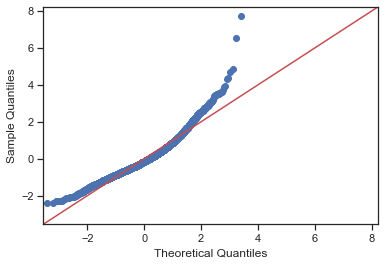

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

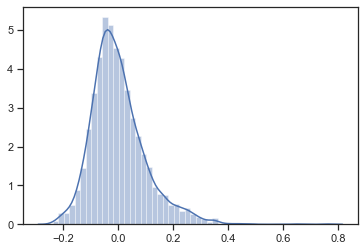

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

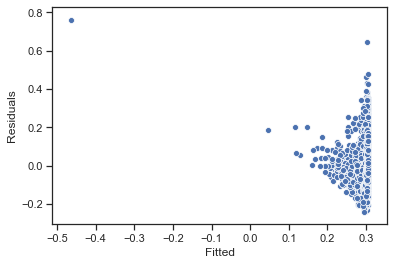

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

# The following works are for Diarrheal diseases

## States

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Diarrheal diseases') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,2.406220
Alaska,1.343148
Arizona,2.551890
Arkansas,2.016912
California,2.205181


In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.000000,0.040752
total population,0.040752,1.000000


In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

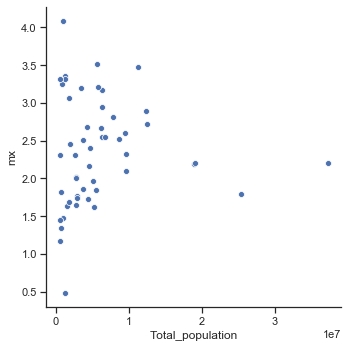

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.002
Model:                            OLS   Adj. R-squared:                 -0.019
Method:                 Least Squares   F-statistic:                   0.08151
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.776
Time:                        23:36:27   Log-Likelihood:                -874.29
No. Observations:                  51   AIC:                             1753.
Df Residuals:                      49   BIC:                             1756.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   5.075e+06   3.35e+06      1.515      0.136   -1.66e+06    1.18e+07
mx          3.887e+05   1.36e+06      0.285      0.776   -2.35e+06    3.12e+06
==============================================================================
Omnibus:                       49.352   Durbin-Watson:                   2.155
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              202.855
Skew:                           2.647   Prob(JB):                     8.93e-45
Kurtosis:                      11.212   Cond. No.                         9.86
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

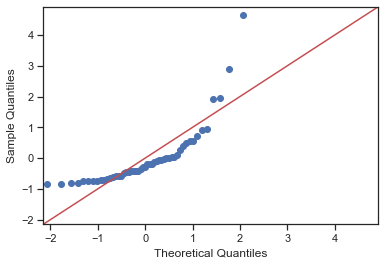

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

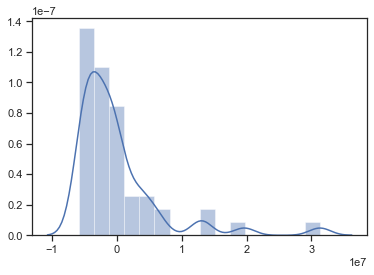

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

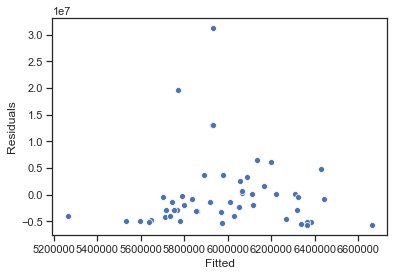

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (state)

In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,-0.100933
FracPopUndPov,-0.100933,1.000000


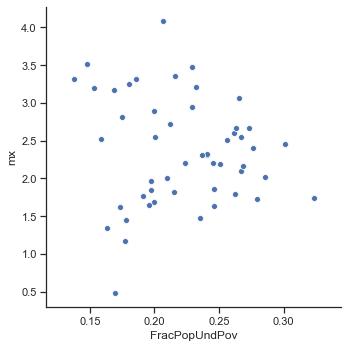

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.010
Model:                            OLS   Adj. R-squared:                 -0.010
Method:                 Least Squares   F-statistic:                    0.5043
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.481
Time:                        23:36:28   Log-Likelihood:                 88.336
No. Observations:                  51   AIC:                            -172.7
Df Residuals:                      49   BIC:                            -168.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.2363      0.021     11.113      0.000       0.194       0.279
mx            -0.0061      0.009     -0.710      0.481      -0.024       0.011
==============================================================================
Omnibus:                        3.377   Durbin-Watson:                   2.029
Prob(Omnibus):                  0.185   Jarque-Bera (JB):                1.687
Skew:                           0.056   Prob(JB):                        0.430
Kurtosis:                       2.116   Cond. No.                         9.86
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

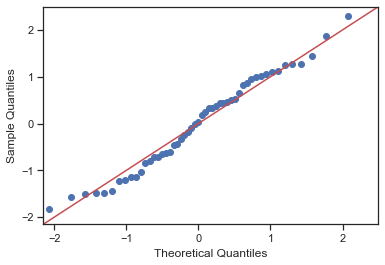

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

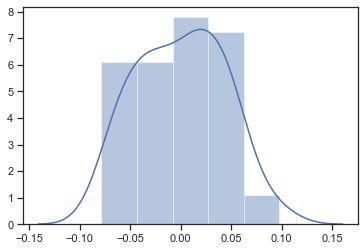

In [ ]:
sns.distplot(lin_pl_state_2.resid)

Text(0, 0.5, 'Residuals')

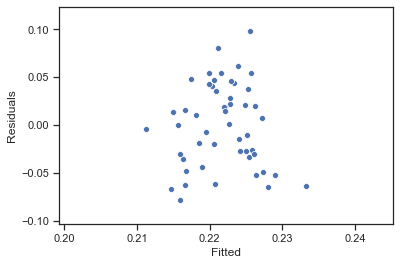

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for state -  Diarrheal diseases

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.346502
PopWHeaIns_1_38,-0.346502,1.000000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_38,NAME
0,2.406220,0.289204,Alabama
1,1.343148,0.228478,Alaska
2,2.551890,0.233423,Arizona
3,2.016912,0.241906,Arkansas
4,2.205181,0.236203,California


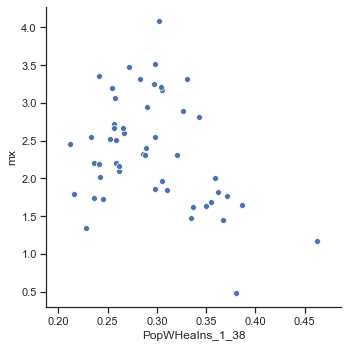

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.120
Model:                            OLS   Adj. R-squared:                  0.102
Method:                 Least Squares   F-statistic:                     6.686
Date:                Sun, 13 Oct 2019   Prob (F-statistic):             0.0127
Time:                        23:36:28   Log-Likelihood:                 82.472
No. Observations:                  51   AIC:                            -160.9
Df Residuals:                      49   BIC:                            -157.1
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3529      0.024     14.798      0.000       0.305       0.401
mx            -0.0251      0.010     -2.586      0.013      -0.045      -0.006
==============================================================================
Omnibus:                        0.384   Durbin-Watson:                   1.794
Prob(Omnibus):                  0.825   Jarque-Bera (JB):                0.299
Skew:                           0.179   Prob(JB):                        0.861
Kurtosis:                       2.888   Cond. No.                         9.86
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

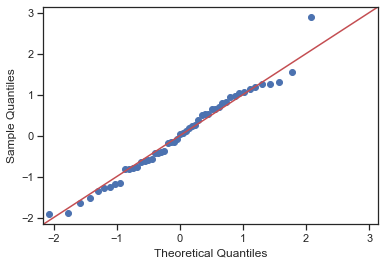

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

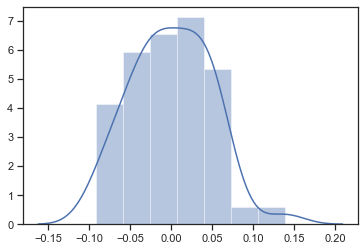

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

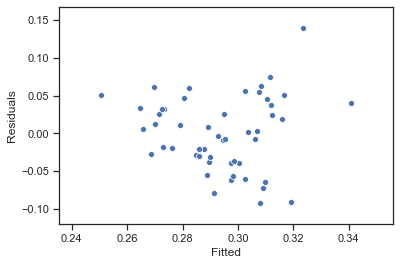

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Diarrheal diseases') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,1.889825
1003.0,1.436522
1005.0,2.015340
1007.0,2.707614
1009.0,3.559936


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,1.889825,54156.0,1001
1,1.436522,188357.0,1003
2,2.015340,24215.0,1005
3,2.707614,21095.0,1007
4,3.559936,57052.0,1009


In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.00000,0.07174
total population,0.07174,1.00000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

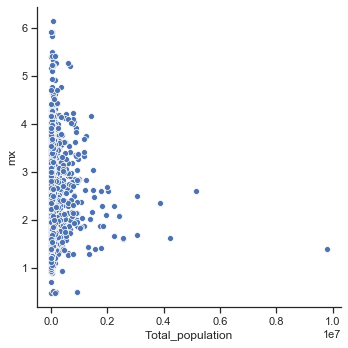

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.005
Model:                            OLS   Adj. R-squared:                  0.005
Method:                 Least Squares   F-statistic:                     16.23
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           5.73e-05
Time:                        23:36:29   Log-Likelihood:                -44193.
No. Observations:                3140   AIC:                         8.839e+04
Df Residuals:                    3138   BIC:                         8.840e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept    3.35e+04   1.68e+04      1.995      0.046     577.886    6.64e+04
mx          2.887e+04   7164.951      4.029      0.000    1.48e+04    4.29e+04
==============================================================================
Omnibus:                     6010.403   Durbin-Watson:                   1.858
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         15819124.414
Skew:                          14.448   Prob(JB):                         0.00
Kurtosis:                     349.519   Cond. No.                         8.19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

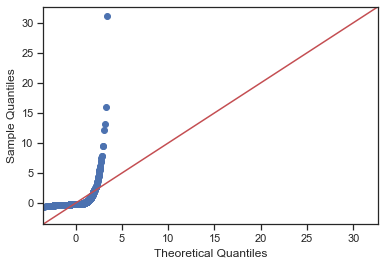

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

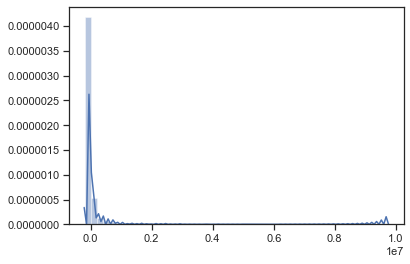

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

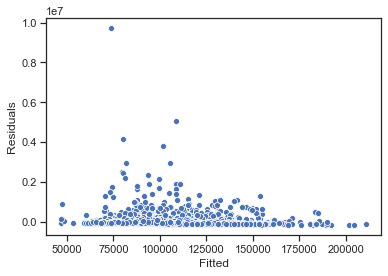

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (county)

In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.096629
FracPopUndPov,0.096629,1.000000


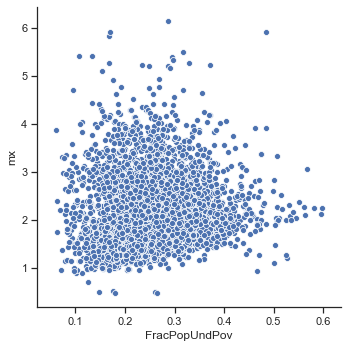

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.009
Model:                            OLS   Adj. R-squared:                  0.009
Method:                 Least Squares   F-statistic:                     29.58
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           5.79e-08
Time:                        23:36:30   Log-Likelihood:                 3373.8
No. Observations:                3140   AIC:                            -6744.
Df Residuals:                    3138   BIC:                            -6732.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.2307      0.004     52.123      0.000       0.222       0.239
mx             0.0103      0.002      5.438      0.000       0.007       0.014
==============================================================================
Omnibus:                      164.374   Durbin-Watson:                   1.344
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              195.582
Skew:                           0.552   Prob(JB):                     3.39e-43
Kurtosis:                       3.526   Cond. No.                         8.19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

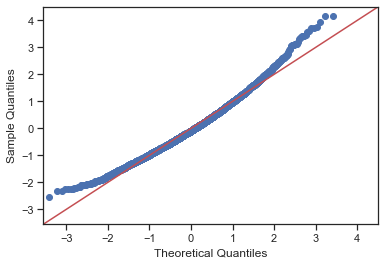

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

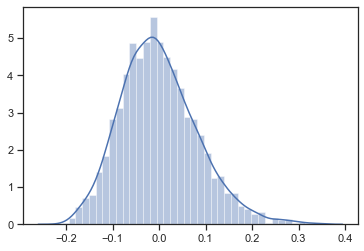

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

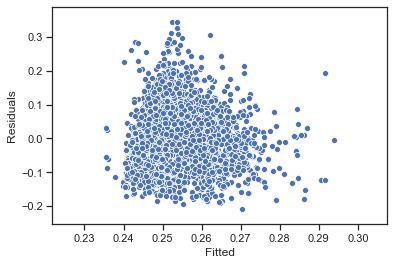

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for county – Diarrheal diseases

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.00000,-0.19219
PopWHeaIns_1_38,-0.19219,1.00000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_38,FIPS_new
0,1.889825,0.381169,1001
1,1.436522,0.301172,1003
2,2.015340,0.217912,1005
3,2.707614,0.311698,1007
4,3.559936,0.287661,1009


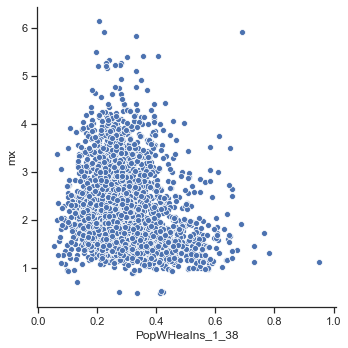

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.037
Model:                            OLS   Adj. R-squared:                  0.037
Method:                 Least Squares   F-statistic:                     120.4
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.66e-27
Time:                        23:36:31   Log-Likelihood:                 2785.1
No. Observations:                3140   AIC:                            -5566.
Df Residuals:                    3138   BIC:                            -5554.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3469      0.005     64.969      0.000       0.336       0.357
mx            -0.0250      0.002    -10.971      0.000      -0.029      -0.021
==============================================================================
Omnibus:                      443.870   Durbin-Watson:                   1.441
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              813.385
Skew:                           0.901   Prob(JB):                    2.38e-177
Kurtosis:                       4.724   Cond. No.                         8.19
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

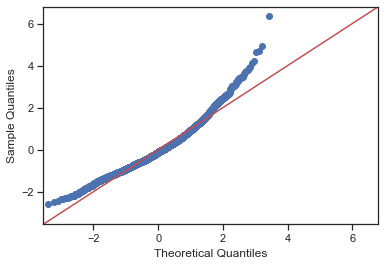

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

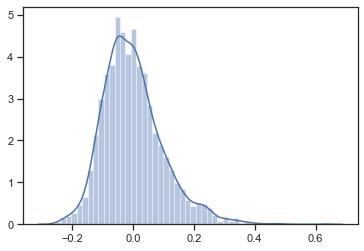

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

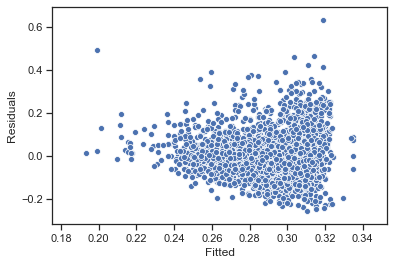

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

# The following works are for Meningitis

## States

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Meningitis') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,0.582372
Alaska,0.431981
Arizona,0.434521
Arkansas,0.520116
California,0.310342


In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.000000,-0.021971
total population,-0.021971,1.000000


In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

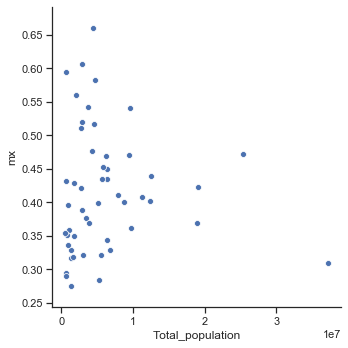

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.020
Method:                 Least Squares   F-statistic:                   0.02367
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.878
Time:                        23:36:32   Log-Likelihood:                -874.32
No. Observations:                  51   AIC:                             1753.
Df Residuals:                      49   BIC:                             1757.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   6.668e+06   4.51e+06      1.479      0.145   -2.39e+06    1.57e+07
mx         -1.629e+06   1.06e+07     -0.154      0.878   -2.29e+07    1.96e+07
==============================================================================
Omnibus:                       48.040   Durbin-Watson:                   2.162
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              188.696
Skew:                           2.583   Prob(JB):                     1.06e-41
Kurtosis:                      10.882   Cond. No.                         12.9
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

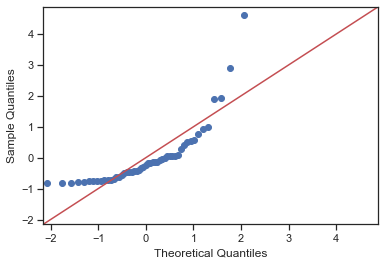

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

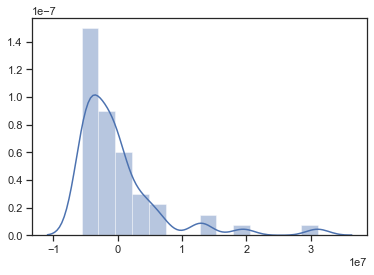

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

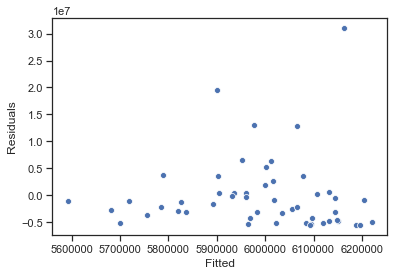

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (state)

In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,0.681913
FracPopUndPov,0.681913,1.000000


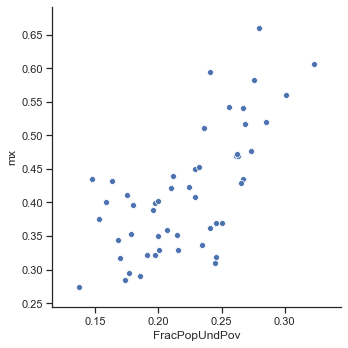

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.465
Model:                            OLS   Adj. R-squared:                  0.454
Method:                 Least Squares   F-statistic:                     42.59
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           3.60e-08
Time:                        23:36:33   Log-Likelihood:                 104.02
No. Observations:                  51   AIC:                            -204.0
Df Residuals:                      49   BIC:                            -200.2
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0878      0.021      4.174      0.000       0.046       0.130
mx             0.3223      0.049      6.526      0.000       0.223       0.422
==============================================================================
Omnibus:                        1.236   Durbin-Watson:                   2.083
Prob(Omnibus):                  0.539   Jarque-Bera (JB):                1.234
Skew:                          -0.343   Prob(JB):                        0.540
Kurtosis:                       2.666   Cond. No.                         12.9
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

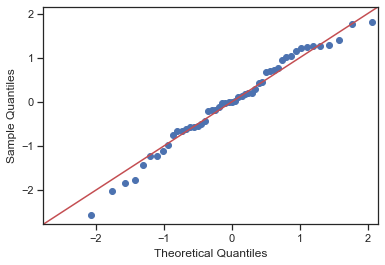

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

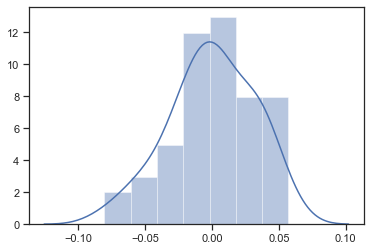

In [ ]:
sns.distplot(lin_pl_state_2.resid)

Text(0, 0.5, 'Residuals')

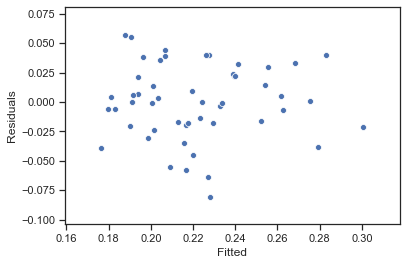

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for state - Meningitis

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.00000,-0.50152
PopWHeaIns_1_38,-0.50152,1.00000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_38,NAME
0,0.582372,0.289204,Alabama
1,0.431981,0.228478,Alaska
2,0.434521,0.233423,Arizona
3,0.520116,0.241906,Arkansas
4,0.310342,0.236203,California


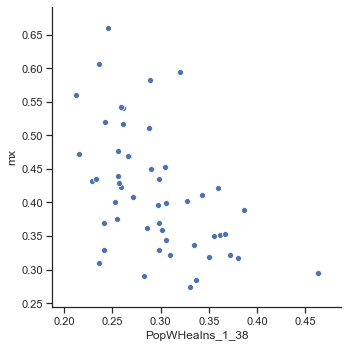

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.252
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     16.47
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           0.000178
Time:                        23:36:34   Log-Likelihood:                 86.598
No. Observations:                  51   AIC:                            -169.2
Df Residuals:                      49   BIC:                            -165.3
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4112      0.030     13.895      0.000       0.352       0.471
mx            -0.2820      0.070     -4.058      0.000      -0.422      -0.142
==============================================================================
Omnibus:                        3.186   Durbin-Watson:                   2.224
Prob(Omnibus):                  0.203   Jarque-Bera (JB):                2.268
Skew:                           0.486   Prob(JB):                        0.322
Kurtosis:                       3.348   Cond. No.                         12.9
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

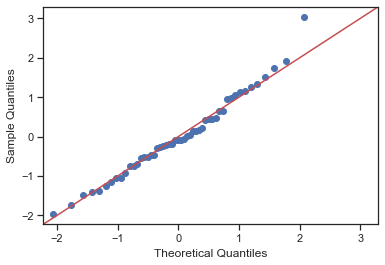

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

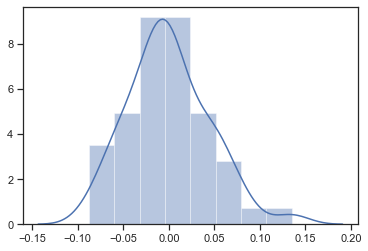

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

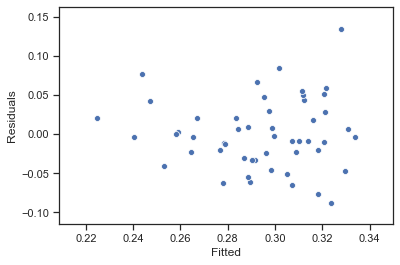

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Meningitis') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,0.514925
1003.0,0.414002
1005.0,0.635688
1007.0,0.612928
1009.0,0.464294


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,0.514925,54156.0,1001
1,0.414002,188357.0,1003
2,0.635688,24215.0,1005
3,0.612928,21095.0,1007
4,0.464294,57052.0,1009


In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.000000,-0.016226
total population,-0.016226,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

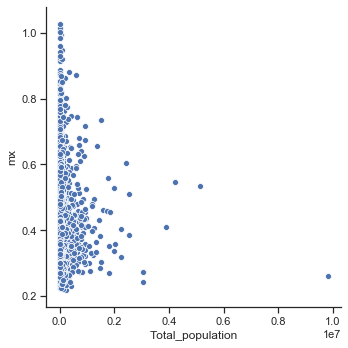

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.000
Model:                            OLS   Adj. R-squared:                 -0.000
Method:                 Least Squares   F-statistic:                    0.8264
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.363
Time:                        23:36:35   Log-Likelihood:                -44201.
No. Observations:                3140   AIC:                         8.841e+04
Df Residuals:                    3138   BIC:                         8.842e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   1.145e+05   1.97e+04      5.801      0.000    7.58e+04    1.53e+05
mx          -4.09e+04    4.5e+04     -0.909      0.363   -1.29e+05    4.73e+04
==============================================================================
Omnibus:                     5975.499   Durbin-Watson:                   1.845
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         15192933.738
Skew:                          14.270   Prob(JB):                         0.00
Kurtosis:                     342.573   Cond. No.                         9.46
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

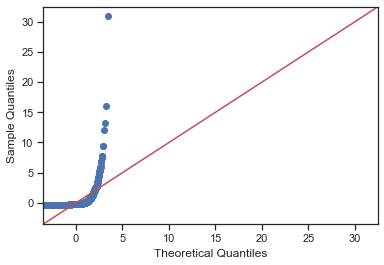

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

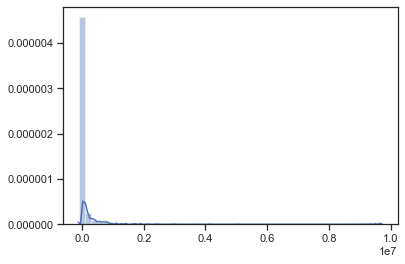

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

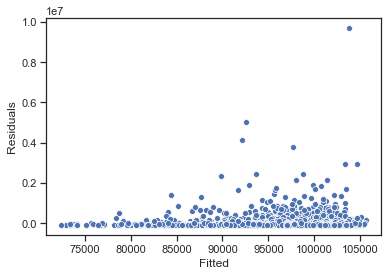

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (county)

In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.686817
FracPopUndPov,0.686817,1.000000


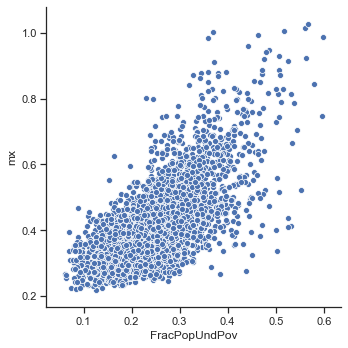

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.472
Model:                            OLS   Adj. R-squared:                  0.472
Method:                 Least Squares   F-statistic:                     2802.
Date:                Sun, 13 Oct 2019   Prob (F-statistic):               0.00
Time:                        23:36:36   Log-Likelihood:                 4361.0
No. Observations:                3140   AIC:                            -8718.
Df Residuals:                    3138   BIC:                            -8706.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0611      0.004     16.107      0.000       0.054       0.068
mx             0.4573      0.009     52.934      0.000       0.440       0.474
==============================================================================
Omnibus:                      130.719   Durbin-Watson:                   1.605
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              198.014
Skew:                           0.381   Prob(JB):                     1.00e-43
Kurtosis:                       3.966   Cond. No.                         9.46
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

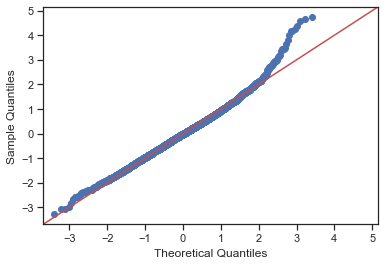

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

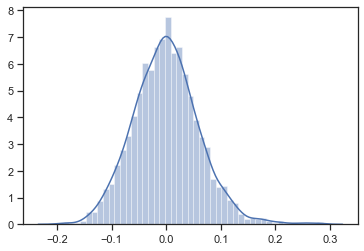

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

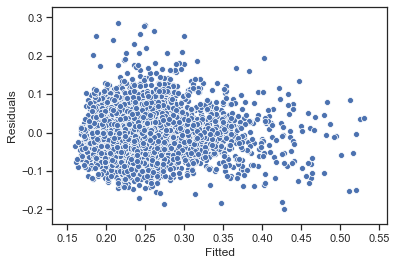

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for county – Meningitis

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.485754
PopWHeaIns_1_38,-0.485754,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_38,FIPS_new
0,0.514925,0.381169,1001
1,0.414002,0.301172,1003
2,0.635688,0.217912,1005
3,0.612928,0.311698,1007
4,0.464294,0.287661,1009


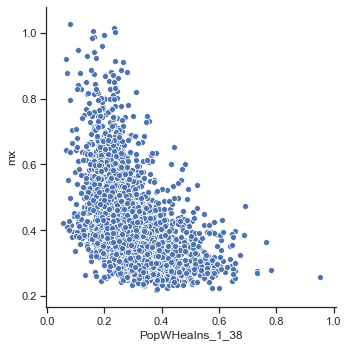

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.236
Model:                            OLS   Adj. R-squared:                  0.236
Method:                 Least Squares   F-statistic:                     969.1
Date:                Sun, 13 Oct 2019   Prob (F-statistic):          1.20e-185
Time:                        23:36:37   Log-Likelihood:                 3148.6
No. Observations:                3140   AIC:                            -6293.
Df Residuals:                    3138   BIC:                            -6281.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4581      0.006     82.148      0.000       0.447       0.469
mx            -0.3957      0.013    -31.130      0.000      -0.421      -0.371
==============================================================================
Omnibus:                      530.886   Durbin-Watson:                   1.574
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             1153.629
Skew:                           0.982   Prob(JB):                    3.11e-251
Kurtosis:                       5.227   Cond. No.                         9.46
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

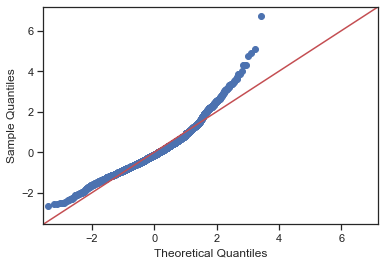

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

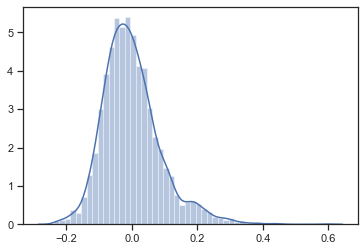

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

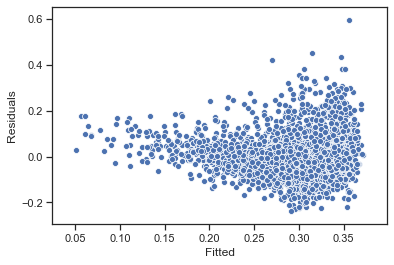

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

# The following works are for Hepatitis

## States

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Hepatitis') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,0.239779
Alaska,0.285058
Arizona,0.335842
Arkansas,0.297565
California,0.492770


In [ ]:
resp_data_state_merge = resp_data_state.merge(s_df_pop[['total population','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,total population
mx,1.000000,0.378965
total population,0.378965,1.000000


In [ ]:
resp_data_state_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

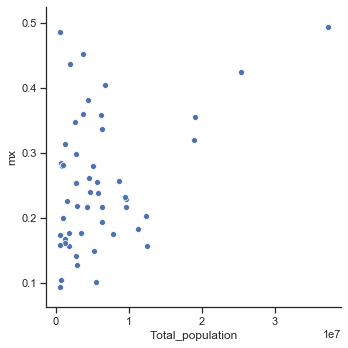

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.144
Model:                            OLS   Adj. R-squared:                  0.126
Method:                 Least Squares   F-statistic:                     8.217
Date:                Sun, 13 Oct 2019   Prob (F-statistic):            0.00610
Time:                        23:36:37   Log-Likelihood:                -870.38
No. Observations:                  51   AIC:                             1745.
Df Residuals:                      49   BIC:                             1749.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept  -4.852e+05   2.43e+06     -0.200      0.842   -5.37e+06     4.4e+06
mx          2.551e+07    8.9e+06      2.867      0.006    7.63e+06    4.34e+07
==============================================================================
Omnibus:                       26.894   Durbin-Watson:                   2.378
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               52.133
Skew:                           1.589   Prob(JB):                     4.78e-12
Kurtosis:                       6.799   Cond. No.                         10.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

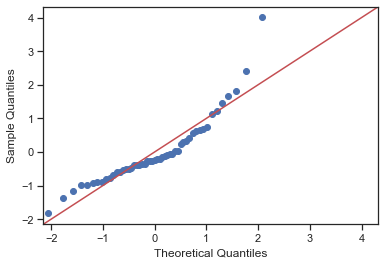

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

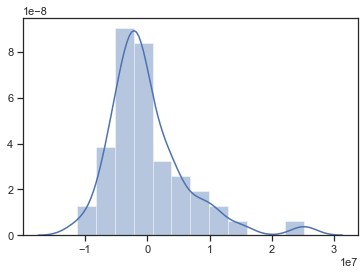

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

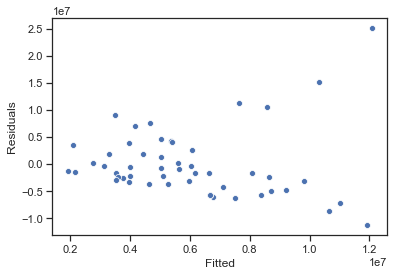

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (state)

In [ ]:
resp_data_state_merge_pov = resp_data_state.merge(ss[['FracPopUndPov','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_pov.corr()

,mx,FracPopUndPov
mx,1.000000,0.405478
FracPopUndPov,0.405478,1.000000


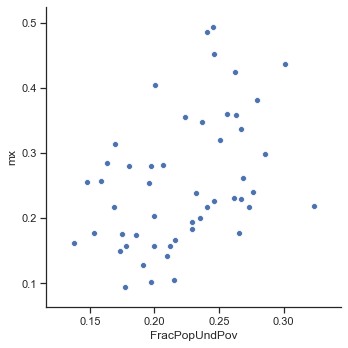

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_state_merge_pov)

In [ ]:
lin_pl_state_2 = smf.ols('FracPopUndPov ~ mx', data=resp_data_state_merge_pov).fit()
lin_pl_state_2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.164
Model:                            OLS   Adj. R-squared:                  0.147
Method:                 Least Squares   F-statistic:                     9.641
Date:                Sun, 13 Oct 2019   Prob (F-statistic):            0.00316
Time:                        23:36:38   Log-Likelihood:                 92.655
No. Observations:                  51   AIC:                            -181.3
Df Residuals:                      49   BIC:                            -177.4
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1776      0.015     11.613      0.000       0.147       0.208
mx             0.1740      0.056      3.105      0.003       0.061       0.287
==============================================================================
Omnibus:                        0.217   Durbin-Watson:                   1.984
Prob(Omnibus):                  0.897   Jarque-Bera (JB):                0.346
Skew:                           0.138   Prob(JB):                        0.841
Kurtosis:                       2.706   Cond. No.                         10.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

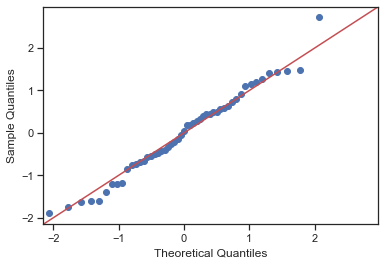

In [ ]:
sm.qqplot(lin_pl_state_2.resid, fit=True, line='45')
plt.show()

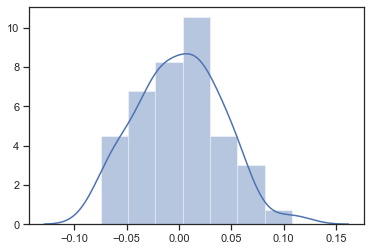

In [ ]:
sns.distplot(lin_pl_state_2.resid)

Text(0, 0.5, 'Residuals')

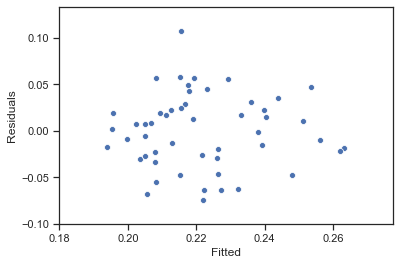

In [ ]:
sns.scatterplot(lin_pl_state_2.fittedvalues, lin_pl_state_2.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for state - Hepatitis

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_38','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_38
mx,1.00000,-0.47354
PopWHeaIns_1_38,-0.47354,1.00000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_38,NAME
0,0.239779,0.289204,Alabama
1,0.285058,0.228478,Alaska
2,0.335842,0.233423,Arizona
3,0.297565,0.241906,Arkansas
4,0.492770,0.236203,California


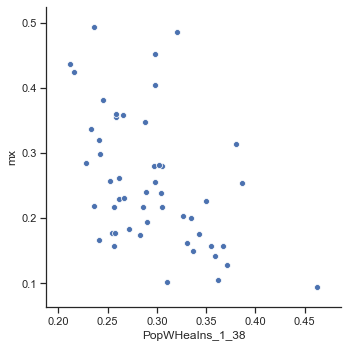

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.224
Model:                            OLS   Adj. R-squared:                  0.208
Method:                 Least Squares   F-statistic:                     14.16
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           0.000449
Time:                        23:36:39   Log-Likelihood:                 85.685
No. Observations:                  51   AIC:                            -167.4
Df Residuals:                      49   BIC:                            -163.5
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3553      0.018     20.259      0.000       0.320       0.390
mx            -0.2418      0.064     -3.763      0.000      -0.371      -0.113
==============================================================================
Omnibus:                        4.674   Durbin-Watson:                   2.236
Prob(Omnibus):                  0.097   Jarque-Bera (JB):                3.956
Skew:                           0.678   Prob(JB):                        0.138
Kurtosis:                       3.157   Cond. No.                         10.6
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

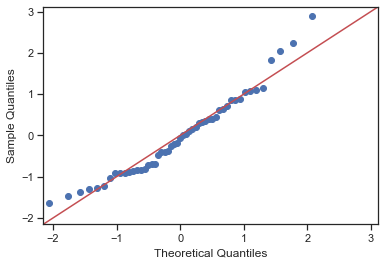

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

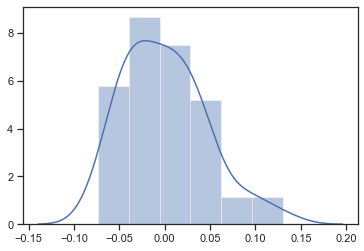

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

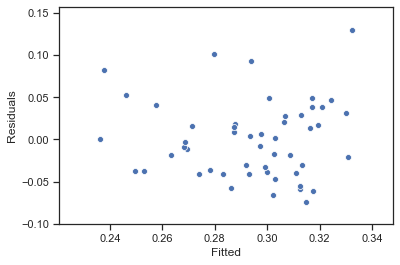

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Hepatitis') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,0.197764
1003.0,0.210261
1005.0,0.201652
1007.0,0.200895
1009.0,0.207240


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_df_pop[['total population','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,total population,FIPS_new
0,0.197764,54156.0,1001
1,0.210261,188357.0,1003
2,0.201652,24215.0,1005
3,0.200895,21095.0,1007
4,0.207240,57052.0,1009


In [ ]:
resp_data_county_merge_drop = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge_drop.corr()

,mx,total population
mx,1.000000,0.156719
total population,0.156719,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'total population':'Total_population'}, inplace = True) 

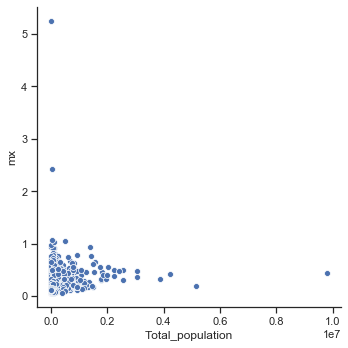

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.025
Model:                            OLS   Adj. R-squared:                  0.024
Method:                 Least Squares   F-statistic:                     79.01
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.02e-18
Time:                        23:36:40   Log-Likelihood:                -44163.
No. Observations:                3140   AIC:                         8.833e+04
Df Residuals:                    3138   BIC:                         8.834e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept   2.755e+04   9605.169      2.868      0.004    8717.118    4.64e+04
mx          3.169e+05   3.56e+04      8.889      0.000    2.47e+05    3.87e+05
==============================================================================
Omnibus:                     5984.645   Durbin-Watson:                   1.891
Prob(Omnibus):                  0.000   Jarque-Bera (JB):         15841813.149
Skew:                          14.299   Prob(JB):                         0.00
Kurtosis:                     349.794   Cond. No.                         6.75
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

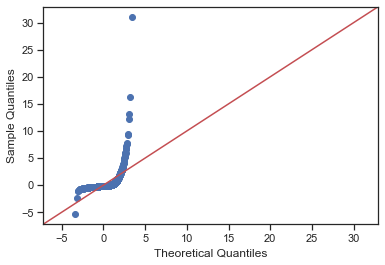

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

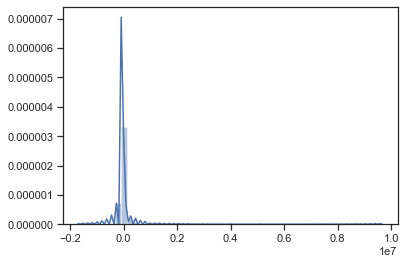

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

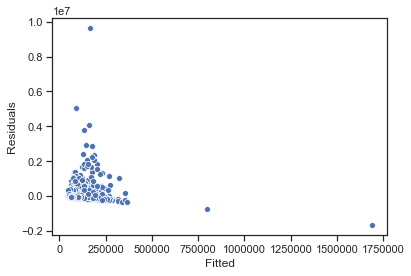

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## Fraction of the population below the poverty line (county)

In [ ]:
resp_data_county_merge_pov = resp_data_county.merge(ss_county[['FracPopUndPov','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_pov_drop = resp_data_county_merge_pov.drop(['FIPS_new'], axis=1)
resp_data_county_merge_pov_drop.corr()

,mx,FracPopUndPov
mx,1.000000,0.267268
FracPopUndPov,0.267268,1.000000


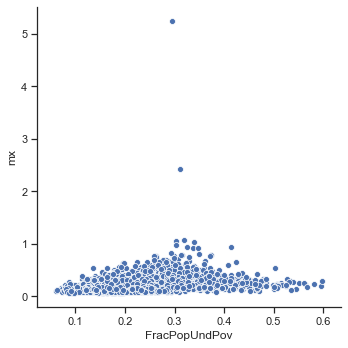

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="FracPopUndPov", y="mx", data=resp_data_county_merge_pov_drop)

In [ ]:
lin_pl_county = smf.ols('FracPopUndPov ~ mx', data=resp_data_county_merge_pov_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:          FracPopUndPov   R-squared:                       0.071
Model:                            OLS   Adj. R-squared:                  0.071
Method:                 Least Squares   F-statistic:                     241.4
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           1.68e-52
Time:                        23:36:41   Log-Likelihood:                 3475.5
No. Observations:                3140   AIC:                            -6947.
Df Residuals:                    3138   BIC:                            -6935.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.2220      0.002     89.675      0.000       0.217       0.227
mx             0.1427      0.009     15.537      0.000       0.125       0.161
==============================================================================
Omnibus:                      277.644   Durbin-Watson:                   1.430
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              823.450
Skew:                           0.462   Prob(JB):                    1.55e-179
Kurtosis:                       5.332   Cond. No.                         6.75
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

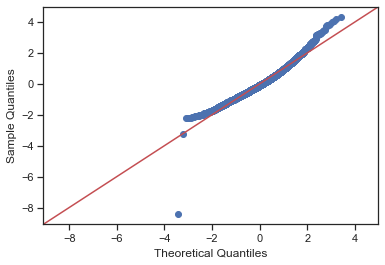

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

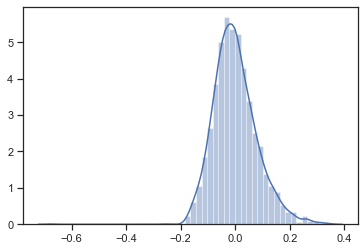

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

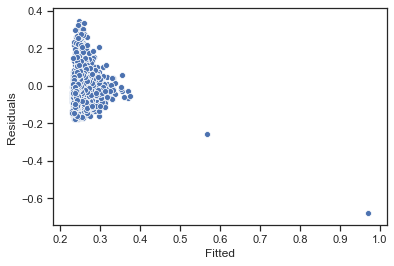

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for county – Hepatitis

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_38','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_38
mx,1.000000,-0.287933
PopWHeaIns_1_38,-0.287933,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_38,FIPS_new
0,0.197764,0.381169,1001
1,0.210261,0.301172,1003
2,0.201652,0.217912,1005
3,0.200895,0.311698,1007
4,0.207240,0.287661,1009


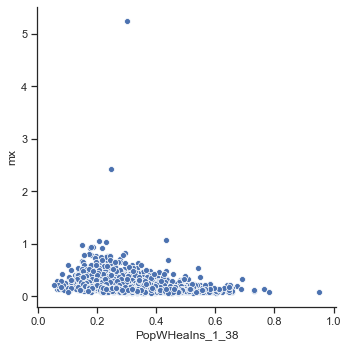

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_38", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_38 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_38   R-squared:                       0.083
Model:                            OLS   Adj. R-squared:                  0.083
Method:                 Least Squares   F-statistic:                     283.7
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           5.26e-61
Time:                        23:36:42   Log-Likelihood:                 2861.9
No. Observations:                3140   AIC:                            -5720.
Df Residuals:                    3138   BIC:                            -5708.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3331      0.003    110.660      0.000       0.327       0.339
mx            -0.1881      0.011    -16.843      0.000      -0.210      -0.166
==============================================================================
Omnibus:                      848.221   Durbin-Watson:                   1.565
Prob(Omnibus):                  0.000   Jarque-Bera (JB):             3757.666
Skew:                           1.240   Prob(JB):                         0.00
Kurtosis:                       7.750   Cond. No.                         6.75
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

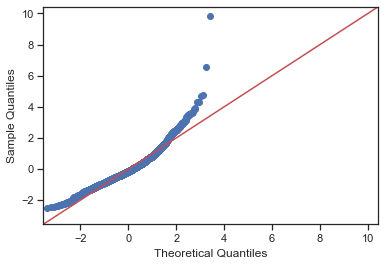

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

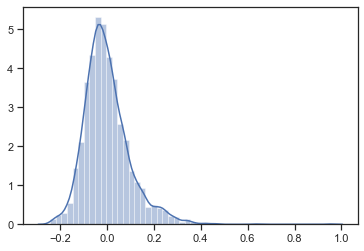

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

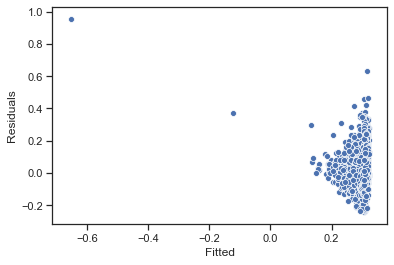

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

# Trial

In [ ]:
trial = c.acs.state(('NAME','C27017_001E','C27017_002E','C27017_003E','C27017_004E','C27017_005E','C27017_006E','C27017_009E','B00001_001E'),'*', year=2014)
#trial.head()

In [ ]:
trial_df = pd.DataFrame(trial)
trial_df.head()

,B00001_001E,C27017_001E,C27017_002E,C27017_003E,C27017_004E,C27017_005E,C27017_006E,C27017_009E,NAME,state
0,399744,4687615.0,1294017.0,413177.0,78638.0,334539.0,741157.0,139683.0,Alabama,01
1,95089,699593.0,114151.0,39572.0,8073.0,31499.0,67460.0,7119.0,Alaska,02
2,454290,6399873.0,1711028.0,586498.0,101064.0,485434.0,968920.0,155610.0,Arizona,04
3,242391,2857966.0,815516.0,268676.0,33349.0,235327.0,454738.0,92102.0,Arkansas,05
4,2749907,37243757.0,9127115.0,2981737.0,528464.0,2453273.0,5310155.0,835223.0,California,06


In [ ]:
trial2 = c.acs.state(('NAME','C27017_001E','C27017_002E','C27017_012E','C27017_022E','C27017_032E'),'*', year=2014)
#trial.head()
trial_df_2 = pd.DataFrame(trial2)
trial_df_2.head()
# total(001) is the sum up of the thresold ones

,C27017_001E,C27017_002E,C27017_012E,C27017_022E,C27017_032E,NAME,state
0,4687615.0,1294017.0,592137.0,1440781.0,1360680.0,Alabama,01
1,699593.0,114151.0,70251.0,201885.0,313306.0,Alaska,02
2,6399873.0,1711028.0,796827.0,1959928.0,1932090.0,Arizona,04
3,2857966.0,815516.0,411329.0,896095.0,735026.0,Arkansas,05
4,37243757.0,9127115.0,4434498.0,10202126.0,13480018.0,California,06


# 5. Extra Credit

In the previous section We have checked the relationship between different diseases and Total population, Fraction of the population below the poverty line, Fraction of the population with health insurance coverage 

Lets look at three other parameters. 

So far I have looked at the Fraction of the population below the poverty line for population thresold Under 1.38. Lets look at the Fraction of the population below the poverty line for thresold of 1.38-1.99

Lets also look at the Fraction of the population with health insurance coverage for thresold of 1.38-1.99

From the documnentation I checked that there is data for people without private health insuarnce, for population thresold of 1.38-1.99 I would look at the Fraction of the population without health insurance coverage

I would check at all of these 3 parameters for Lower Respiratory Disease


## States

In [ ]:
resp_data_state = pd.DataFrame((state_Mort_rate[(state_Mort_rate['cause_name']=='Lower respiratory infections') & 
                ((state_Mort_rate['year_id']==2014))&(state_Mort_rate['sex']=='Both')]).groupby('location_name')['mx'].sum())
resp_data_state.reset_index()
resp_data_state.head()

,mx
location_name,
Alabama,37.393408
Alaska,17.639234
Arizona,18.021531
Arkansas,38.644030
California,20.695523


In [ ]:
s_df_pop.head()

,B00001_001E,total population,population under poverty,NAME,FIPS,FracPopUndPov
0,399744,4687615.0,1294017.0,Alabama,01,0.276050
1,95089,699593.0,114151.0,Alaska,02,0.163168
2,454290,6399873.0,1711028.0,Arizona,04,0.267353
3,242391,2857966.0,815516.0,Arkansas,05,0.285348
4,2749907,37243757.0,9127115.0,California,06,0.245064


In [ ]:
s_hi_pop = c.acs.state(('NAME','C27017_001E','C27017_012E','C27017_014E','C27017_017E','C27017_020E','C27017_015E'
                       ,'C27017_018E','C27017_021E'),'*', year=2014)
#trial.head()
s_hi_pop_df = pd.DataFrame(s_hi_pop)
s_hi_pop_df.rename(columns={
    'state': 'FIPS'
    ,'C27017_001E':'total_population'
    ,'C27017_012E':'population_under_poverty_1_99'
    ,'C27017_014E':'population_hi_18'
    ,'C27017_017E':'population_hi_64'
    ,'C27017_020E':'population_hi_65'
    ,'C27017_015E':'population_wohi_18'
    ,'C27017_018E':'population_wohi_64'
    ,'C27017_021E':'population_wohi_65'}, inplace=True)
s_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,FIPS
0,4687615.0,592137.0,74680.0,71681.0,193156.0,146948.0,60413.0,45259.0,Alabama,01
1,699593.0,70251.0,9605.0,14400.0,16004.0,23154.0,2318.0,4770.0,Alaska,02
2,6399873.0,796827.0,114375.0,116746.0,205329.0,231675.0,63707.0,64995.0,Arizona,04
3,2857966.0,411329.0,43666.0,67218.0,117772.0,112475.0,36646.0,33552.0,Arkansas,05
4,37243757.0,4434498.0,509321.0,719833.0,1139828.0,1519401.0,221037.0,325078.0,California,06


In [ ]:
s_hi_pop_df['FracPopUndPov_1_99'] = s_hi_pop_df['population_under_poverty_1_99'] / s_hi_pop_df['total_population']
s_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,FIPS,FracPopUndPov_1_99
0,4687615.0,592137.0,74680.0,71681.0,193156.0,146948.0,60413.0,45259.0,Alabama,01,0.126319
1,699593.0,70251.0,9605.0,14400.0,16004.0,23154.0,2318.0,4770.0,Alaska,02,0.100417
2,6399873.0,796827.0,114375.0,116746.0,205329.0,231675.0,63707.0,64995.0,Arizona,04,0.124507
3,2857966.0,411329.0,43666.0,67218.0,117772.0,112475.0,36646.0,33552.0,Arkansas,05,0.143924
4,37243757.0,4434498.0,509321.0,719833.0,1139828.0,1519401.0,221037.0,325078.0,California,06,0.119067


In [ ]:
s_hi_pop_df['PopWHeaIns_1_99'] = (s_hi_pop_df['population_hi_18'] + s_hi_pop_df['population_hi_64'] +s_hi_pop_df['population_hi_65'] )/ s_hi_pop_df['population_under_poverty_1_99']
s_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,FIPS,FracPopUndPov_1_99,PopWHeaIns_1_99
0,4687615.0,592137.0,74680.0,71681.0,193156.0,146948.0,60413.0,45259.0,Alabama,01,0.126319,0.554346
1,699593.0,70251.0,9605.0,14400.0,16004.0,23154.0,2318.0,4770.0,Alaska,02,0.100417,0.397532
2,6399873.0,796827.0,114375.0,116746.0,205329.0,231675.0,63707.0,64995.0,Arizona,04,0.124507,0.481172
3,2857966.0,411329.0,43666.0,67218.0,117772.0,112475.0,36646.0,33552.0,Arkansas,05,0.143924,0.481571
4,37243757.0,4434498.0,509321.0,719833.0,1139828.0,1519401.0,221037.0,325078.0,California,06,0.119067,0.421736


In [ ]:
s_hi_pop_df['PopWoutHeaIns_1_99'] = (s_hi_pop_df['population_wohi_18'] + s_hi_pop_df['population_wohi_64'] +s_hi_pop_df['population_wohi_65'] )/ s_hi_pop_df['population_under_poverty_1_99']
s_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,FIPS,FracPopUndPov_1_99,PopWHeaIns_1_99,PopWoutHeaIns_1_99
0,4687615.0,592137.0,74680.0,71681.0,193156.0,146948.0,60413.0,45259.0,Alabama,01,0.126319,0.554346,0.445654
1,699593.0,70251.0,9605.0,14400.0,16004.0,23154.0,2318.0,4770.0,Alaska,02,0.100417,0.397532,0.602468
2,6399873.0,796827.0,114375.0,116746.0,205329.0,231675.0,63707.0,64995.0,Arizona,04,0.124507,0.481172,0.518828
3,2857966.0,411329.0,43666.0,67218.0,117772.0,112475.0,36646.0,33552.0,Arkansas,05,0.143924,0.481571,0.518429
4,37243757.0,4434498.0,509321.0,719833.0,1139828.0,1519401.0,221037.0,325078.0,California,06,0.119067,0.421736,0.578264


In [ ]:
resp_data_state_merge.head()

,mx,Total_population,NAME
0,0.239779,4687615.0,Alabama
1,0.285058,699593.0,Alaska
2,0.335842,6399873.0,Arizona
3,0.297565,2857966.0,Arkansas
4,0.492770,37243757.0,California


## Fraction of the population below the poverty line-state-Thresold (1.38-1.99)

In [ ]:
resp_data_state_merge = resp_data_state.merge(s_hi_pop_df[['FracPopUndPov_1_99','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge.corr()

,mx,FracPopUndPov_1_99
mx,1.000000,0.234858
FracPopUndPov_1_99,0.234858,1.000000


In [ ]:
resp_data_state_merge.rename(columns = {'FracPopUndPov_1_99':'Total_population'}, inplace = True) 

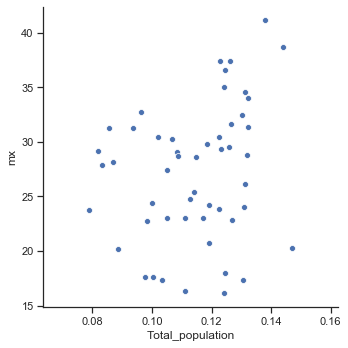

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_state_merge)

In [ ]:
lin_pl_state = smf.ols('Total_population ~ mx', data=resp_data_state_merge).fit()
lin_pl_state.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                  0.036
Method:                 Least Squares   F-statistic:                     2.861
Date:                Sun, 13 Oct 2019   Prob (F-statistic):             0.0971
Time:                        23:36:48   Log-Likelihood:                 138.31
No. Observations:                  51   AIC:                            -272.6
Df Residuals:                      49   BIC:                            -268.8
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.0975      0.010      9.471      0.000       0.077       0.118
mx             0.0006      0.000      1.691      0.097      -0.000       0.001
==============================================================================
Omnibus:                        1.891   Durbin-Watson:                   2.020
Prob(Omnibus):                  0.388   Jarque-Bera (JB):                1.813
Skew:                          -0.432   Prob(JB):                        0.404
Kurtosis:                       2.672   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

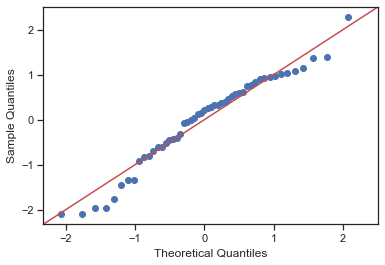

In [ ]:
sm.qqplot(lin_pl_state.resid, fit=True, line='45')
plt.show()

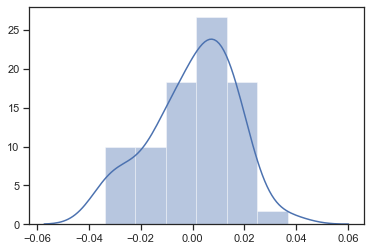

In [ ]:
sns.distplot(lin_pl_state.resid)

Text(0, 0.5, 'Residuals')

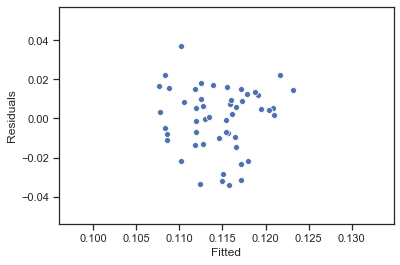

In [ ]:
sns.scatterplot(lin_pl_state.fittedvalues, lin_pl_state.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for state -thresold 1.38-1.99

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWHeaIns_1_99','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWHeaIns_1_99
mx,1.000000,0.057134
PopWHeaIns_1_99,0.057134,1.000000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWHeaIns_1_99,NAME
0,37.393408,0.554346,Alabama
1,17.639234,0.397532,Alaska
2,18.021531,0.481172,Arizona
3,38.644030,0.481571,Arkansas
4,20.695523,0.421736,California


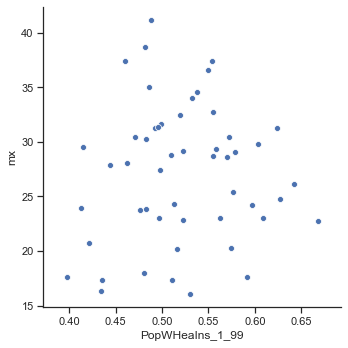

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_99", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWHeaIns_1_99 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_99   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                 -0.017
Method:                 Least Squares   F-statistic:                    0.1605
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.690
Time:                        23:36:48   Log-Likelihood:                 69.306
No. Observations:                  51   AIC:                            -134.6
Df Residuals:                      49   BIC:                            -130.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.5059      0.040     12.697      0.000       0.426       0.586
mx             0.0006      0.001      0.401      0.690      -0.002       0.003
==============================================================================
Omnibus:                        0.874   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.646   Jarque-Bera (JB):                0.939
Skew:                           0.211   Prob(JB):                        0.625
Kurtosis:                       2.486   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

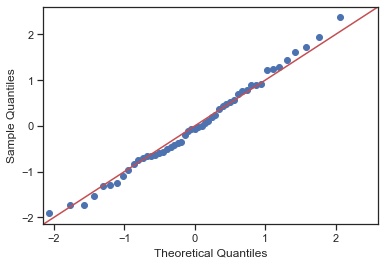

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

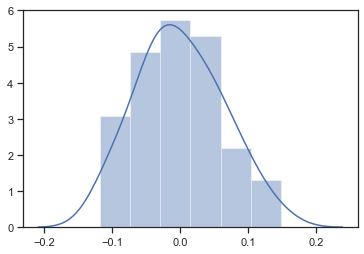

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

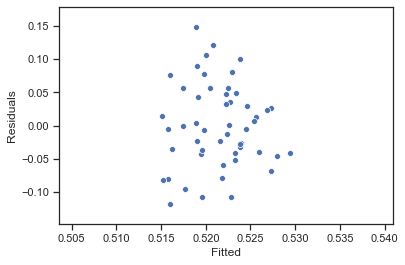

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population without health insurance coverage for state -thresold 1.38-1.99

In [ ]:
resp_data_state_merge_hi = resp_data_state.merge(s_hi_pop_df[['PopWoutHeaIns_1_99','NAME']],how='inner',left_on='location_name',right_on='NAME')
resp_data_state_merge_hi.corr()

,mx,PopWoutHeaIns_1_99
mx,1.000000,-0.057134
PopWoutHeaIns_1_99,-0.057134,1.000000


In [ ]:
resp_data_state_merge_hi.head()

,mx,PopWoutHeaIns_1_99,NAME
0,37.393408,0.445654,Alabama
1,17.639234,0.602468,Alaska
2,18.021531,0.518828,Arizona
3,38.644030,0.518429,Arkansas
4,20.695523,0.578264,California


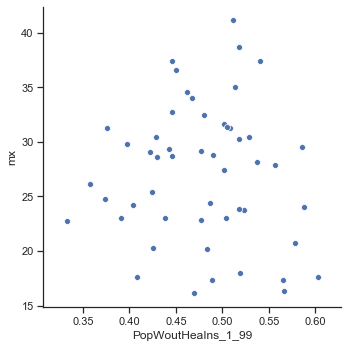

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWoutHeaIns_1_99", y="mx", data=resp_data_state_merge_hi)

In [ ]:
lin_pl_state_3 = smf.ols('PopWoutHeaIns_1_99 ~ mx', data=resp_data_state_merge_hi).fit()
lin_pl_state_3.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     PopWoutHeaIns_1_99   R-squared:                       0.003
Model:                            OLS   Adj. R-squared:                 -0.017
Method:                 Least Squares   F-statistic:                    0.1605
Date:                Sun, 13 Oct 2019   Prob (F-statistic):              0.690
Time:                        23:36:49   Log-Likelihood:                 69.306
No. Observations:                  51   AIC:                            -134.6
Df Residuals:                      49   BIC:                            -130.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.4941      0.040     12.402      0.000       0.414       0.574
mx            -0.0006      0.001     -0.401      0.690      -0.003       0.002
==============================================================================
Omnibus:                        0.874   Durbin-Watson:                   1.745
Prob(Omnibus):                  0.646   Jarque-Bera (JB):                0.939
Skew:                          -0.211   Prob(JB):                        0.625
Kurtosis:                       2.486   Cond. No.                         125.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

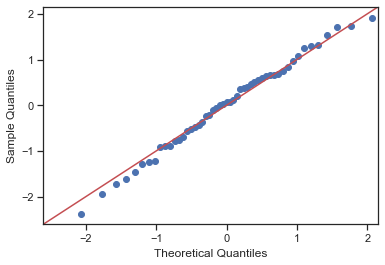

In [ ]:
sm.qqplot(lin_pl_state_3.resid, fit=True, line='45')
plt.show()

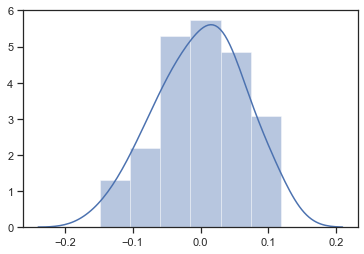

In [ ]:
sns.distplot(lin_pl_state_3.resid)

Text(0, 0.5, 'Residuals')

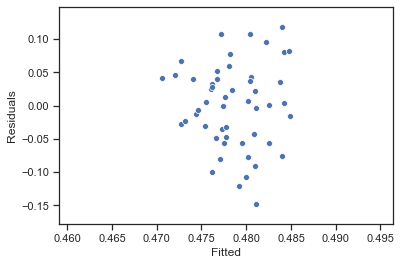

In [ ]:
sns.scatterplot(lin_pl_state_3.fittedvalues, lin_pl_state_3.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

## County

In [ ]:
c_hi_pop = c.acs.state_county(('NAME','C27017_001E','C27017_012E','C27017_014E','C27017_017E','C27017_020E','C27017_015E'
                       ,'C27017_018E','C27017_021E'),'*', '*',year=2014)

Creating dataframe from the dict data

In [ ]:
c_hi_pop_df = pd.DataFrame(c_hi_pop)

In [ ]:
c_hi_pop_df.head()

,C27017_001E,C27017_012E,C27017_014E,C27017_015E,C27017_017E,C27017_018E,C27017_020E,C27017_021E,NAME,county,state
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,06
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,06
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,06
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,06
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,06


Rename state column to FIPS

In [ ]:
# s_hi_pop = c.acs.state(('NAME','C27017_001E','C27017_012E','C27017_014E','C27017_017E','C27017_020E','C27017_015E'
#                        ,'C27017_018E','C27017_021E'),'*', year=2014)
# #trial.head()
# s_hi_pop_df = pd.DataFrame(s_hi_pop)
c_hi_pop_df.rename(columns={
    'state': 'FIPS'
    ,'C27017_001E':'total_population'
    ,'C27017_012E':'population_under_poverty_1_99'
    ,'C27017_014E':'population_hi_18'
    ,'C27017_017E':'population_hi_64'
    ,'C27017_020E':'population_hi_65'
    ,'C27017_015E':'population_wohi_18'
    ,'C27017_018E':'population_wohi_64'
    ,'C27017_021E':'population_wohi_65'}, inplace=True)
c_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,county,FIPS
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,06
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,06
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,06
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,06
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,06


In [ ]:
c_hi_pop_df['FIPS'] = c_hi_pop_df['FIPS'].astype(int)
c_hi_pop_df['FIPS_county'] = c_hi_pop_df['county'].astype(int)
c_hi_pop_df['FIPS_new'] = c_hi_pop_df['FIPS'].multiply(1000) + c_hi_pop_df['FIPS_county']
c_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,county,FIPS,FIPS_county,FIPS_new
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,6,37,6037
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,6,39,6039
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,6,41,6041
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,6,43,6043
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,6,45,6045


In [ ]:
c_hi_pop_df['FracPopUndPov_1_99'] = c_hi_pop_df['population_under_poverty_1_99'] / c_hi_pop_df['total_population']
c_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,county,FIPS,FIPS_county,FIPS_new,FracPopUndPov_1_99
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,6,37,6037,0.131388
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,6,39,6039,0.162161
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,6,41,6041,0.071151
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,6,43,6043,0.116763
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,6,45,6045,0.142151


In [ ]:
c_hi_pop_df['PopWHeaIns_1_99'] = (c_hi_pop_df['population_hi_18'] + c_hi_pop_df['population_hi_64'] +c_hi_pop_df['population_hi_65'] )/ c_hi_pop_df['population_under_poverty_1_99']
c_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,county,FIPS,FIPS_county,FIPS_new,FracPopUndPov_1_99,PopWHeaIns_1_99
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,6,37,6037,0.131388,0.369699
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,6,39,6039,0.162161,0.355700
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,6,41,6041,0.071151,0.524706
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,6,43,6043,0.116763,0.551325
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,6,45,6045,0.142151,0.367108


In [ ]:
c_hi_pop_df['PopWoutHeaIns_1_99'] = (c_hi_pop_df['population_wohi_18'] + c_hi_pop_df['population_wohi_64'] +c_hi_pop_df['population_wohi_65'] )/ c_hi_pop_df['population_under_poverty_1_99']
c_hi_pop_df.head()

,total_population,population_under_poverty_1_99,population_hi_18,population_wohi_18,population_hi_64,population_wohi_64,population_hi_65,population_wohi_65,NAME,county,FIPS,FIPS_county,FIPS_new,FracPopUndPov_1_99,PopWHeaIns_1_99,PopWoutHeaIns_1_99
0,9815811.0,1289677.0,123161.0,209029.0,310615.0,498862.0,43016.0,104994.0,"Los Angeles County, California",037,6,37,6037,0.131388,0.369699,0.630301
1,143740.0,23309.0,2579.0,4443.0,4659.0,9131.0,1053.0,1444.0,"Madera County, California",039,6,39,6039,0.162161,0.355700,0.644300
2,249456.0,17749.0,1647.0,2303.0,5678.0,4803.0,1988.0,1330.0,"Marin County, California",041,6,41,6041,0.071151,0.524706,0.475294
3,17771.0,2075.0,82.0,225.0,791.0,454.0,271.0,252.0,"Mariposa County, California",043,6,43,6043,0.116763,0.551325,0.448675
4,86021.0,12228.0,719.0,2022.0,2690.0,4342.0,1080.0,1375.0,"Mendocino County, California",045,6,45,6045,0.142151,0.367108,0.632892


### Fraction of the population below the poverty line-county-Thresold (1.38-1.99) 

In [ ]:
resp_data_county = pd.DataFrame((county_Mort_rate[(county_Mort_rate['cause_name']=='Lower respiratory infections') & ((county_Mort_rate['year_id']==2014))&(county_Mort_rate['sex']=='Both')]).groupby('state-county')['mx'].sum()) 
resp_data_county.reset_index()
resp_data_county.head()

,mx
state-county,
1001.0,34.153983
1003.0,21.820851
1005.0,33.954553
1007.0,41.295744
1009.0,54.023856


In [ ]:
resp_data_county_merge = resp_data_county.merge(c_hi_pop_df[['FracPopUndPov_1_99','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge.head()

,mx,FracPopUndPov_1_99,FIPS_new
0,34.153983,0.140428,1001
1,21.820851,0.121567,1003
2,33.954553,0.173859,1005
3,41.295744,0.169471,1007
4,54.023856,0.121433,1009


In [ ]:
resp_data_county_merge = resp_data_county_merge.drop(['FIPS_new'], axis=1)
resp_data_county_merge.corr()

,mx,FracPopUndPov_1_99
mx,1.000000,0.233782
FracPopUndPov_1_99,0.233782,1.000000


In [ ]:
resp_data_county_merge.rename(columns = {'FracPopUndPov_1_99':'Total_population'}, inplace = True) 

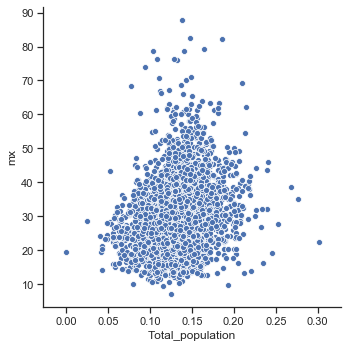

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="Total_population", y="mx", data=resp_data_county_merge)

In [ ]:
lin_pl_county = smf.ols('Total_population ~ mx', data=resp_data_county_merge).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:       Total_population   R-squared:                       0.055
Model:                            OLS   Adj. R-squared:                  0.054
Method:                 Least Squares   F-statistic:                     181.4
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           3.05e-40
Time:                        23:36:52   Log-Likelihood:                 6648.2
No. Observations:                3140   AIC:                        -1.329e+04
Df Residuals:                    3138   BIC:                        -1.328e+04
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.1117      0.002     68.390      0.000       0.108       0.115
mx             0.0007   5.11e-05     13.469      0.000       0.001       0.001
==============================================================================
Omnibus:                      116.070   Durbin-Watson:                   1.725
Prob(Omnibus):                  0.000   Jarque-Bera (JB):              240.511
Skew:                           0.245   Prob(JB):                     5.94e-53
Kurtosis:                       4.264   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

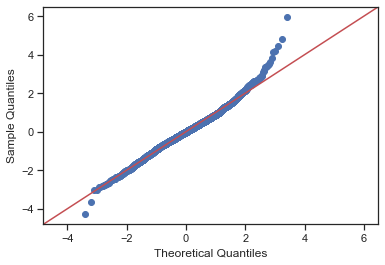

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

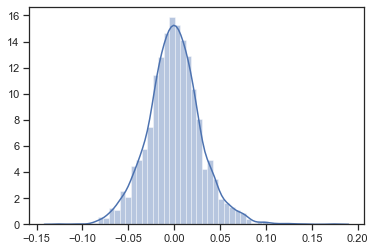

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

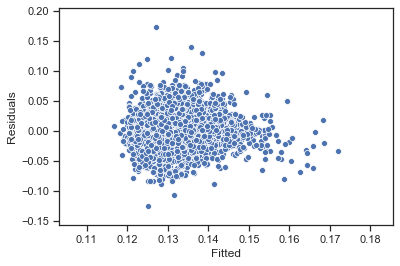

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population with health insurance coverage for county -thresold 1.38-1.99

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWHeaIns_1_99','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWHeaIns_1_99
mx,1.000000,-0.232888
PopWHeaIns_1_99,-0.232888,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWHeaIns_1_99,FIPS_new
0,34.153983,0.614070,1001
1,21.820851,0.559132,1003
2,33.954553,0.493349,1005
3,41.295744,0.559720,1007
4,54.023856,0.649971,1009


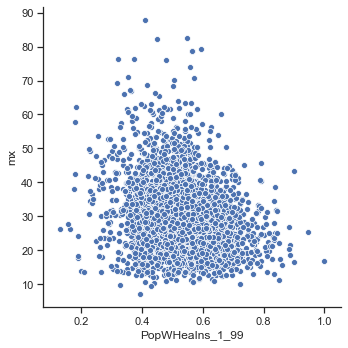

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWHeaIns_1_99", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWHeaIns_1_99 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:        PopWHeaIns_1_99   R-squared:                       0.054
Model:                            OLS   Adj. R-squared:                  0.054
Method:                 Least Squares   F-statistic:                     179.9
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           6.29e-40
Time:                        23:36:53   Log-Likelihood:                 2627.0
No. Observations:                3139   AIC:                            -5250.
Df Residuals:                    3137   BIC:                            -5238.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.6076      0.006    103.368      0.000       0.596       0.619
mx            -0.0025      0.000    -13.413      0.000      -0.003      -0.002
==============================================================================
Omnibus:                       36.529   Durbin-Watson:                   1.366
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               60.508
Skew:                          -0.056   Prob(JB):                     7.26e-14
Kurtosis:                       3.671   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

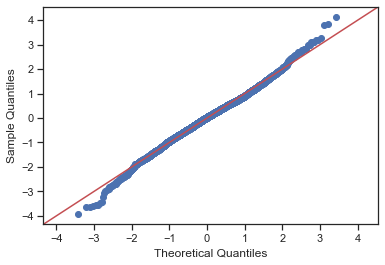

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

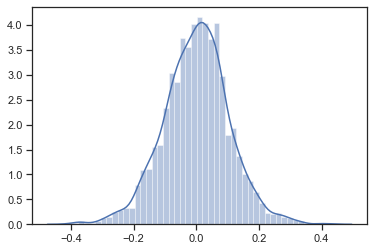

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

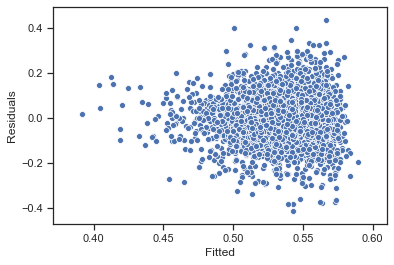

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')

### Fraction of the population without health insurance coverage for county -thresold 1.38-1.99

In [ ]:
resp_data_county_merge_hi = resp_data_county.merge(c_hi_pop_df[['PopWoutHeaIns_1_99','FIPS_new']],how='inner',left_on='state-county',right_on='FIPS_new')
resp_data_county_merge_hi_drop = resp_data_county_merge_hi.drop(['FIPS_new'], axis=1)
resp_data_county_merge_hi_drop.corr()

,mx,PopWoutHeaIns_1_99
mx,1.000000,0.232888
PopWoutHeaIns_1_99,0.232888,1.000000


In [ ]:
resp_data_county_merge_hi.head()

,mx,PopWoutHeaIns_1_99,FIPS_new
0,34.153983,0.385930,1001
1,21.820851,0.440868,1003
2,33.954553,0.506651,1005
3,41.295744,0.440280,1007
4,54.023856,0.350029,1009


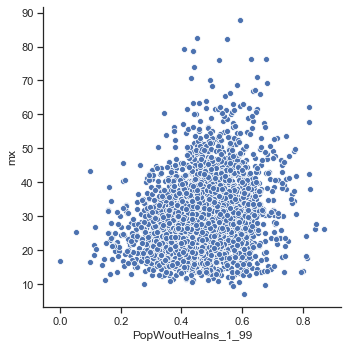

In [ ]:
sns.set(style="ticks")
g = sns.relplot(x="PopWoutHeaIns_1_99", y="mx", data=resp_data_county_merge_hi_drop)

In [ ]:
lin_pl_county = smf.ols('PopWoutHeaIns_1_99 ~ mx', data=resp_data_county_merge_hi_drop).fit()
lin_pl_county.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:     PopWoutHeaIns_1_99   R-squared:                       0.054
Model:                            OLS   Adj. R-squared:                  0.054
Method:                 Least Squares   F-statistic:                     179.9
Date:                Sun, 13 Oct 2019   Prob (F-statistic):           6.29e-40
Time:                        23:36:54   Log-Likelihood:                 2627.0
No. Observations:                3139   AIC:                            -5250.
Df Residuals:                    3137   BIC:                            -5238.
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
Intercept      0.3924      0.006     66.752      0.000       0.381       0.404
mx             0.0025      0.000     13.413      0.000       0.002       0.003
==============================================================================
Omnibus:                       36.529   Durbin-Watson:                   1.366
Prob(Omnibus):                  0.000   Jarque-Bera (JB):               60.508
Skew:                           0.056   Prob(JB):                     7.26e-14
Kurtosis:                       3.671   Cond. No.                         101.
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

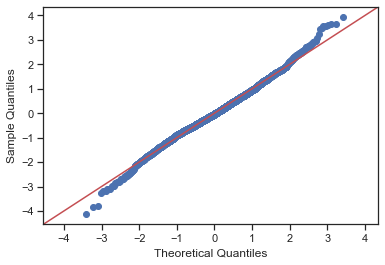

In [ ]:
sm.qqplot(lin_pl_county.resid, fit=True, line='45')
plt.show()

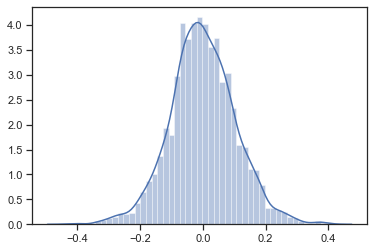

In [ ]:
sns.distplot(lin_pl_county.resid)

Text(0, 0.5, 'Residuals')

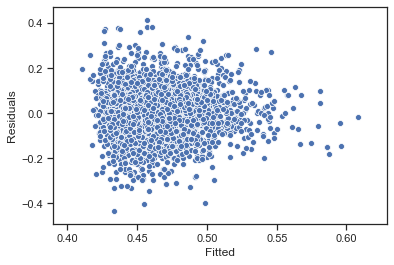

In [ ]:
sns.scatterplot(lin_pl_county.fittedvalues, lin_pl_county.resid)
plt.xlabel('Fitted')
plt.ylabel('Residuals')